# Session (475165_f3_stage2_day6)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f3_stage2_day6" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f3"
day = "day6"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (36200, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


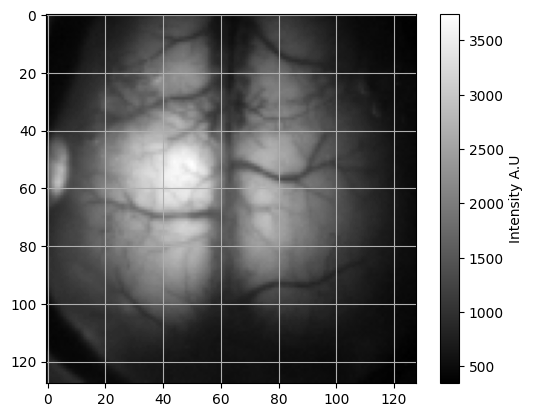

frame number 6000 plotted


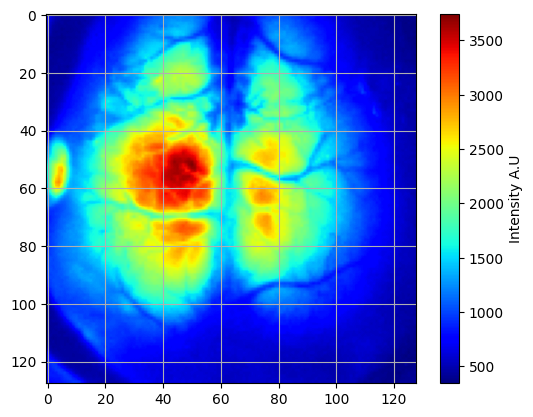

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 353.9181884765625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 398.1579620361328


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 102
Number of double_flash pairs: 51
Number of single_flash: 39
Number of total flashes: 141


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/141 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/141 [00:01<02:55,  1.25s/it]

  1%|█▏                                                                                | 2/141 [00:02<02:55,  1.26s/it]

  2%|█▋                                                                                | 3/141 [00:03<03:02,  1.32s/it]

  3%|██▎                                                                               | 4/141 [00:05<03:05,  1.35s/it]

  4%|██▉                                                                               | 5/141 [00:06<03:01,  1.34s/it]

  4%|███▍                                                                              | 6/141 [00:07<03:01,  1.34s/it]

  5%|████                                                                              | 7/141 [00:09<03:04,  1.37s/it]

  6%|████▋                                                                             | 8/141 [00:10<03:00,  1.36s/it]

  6%|█████▏                                                                            | 9/141 [00:12<02:58,  1.35s/it]

  7%|█████▋                                                                           | 10/141 [00:13<02:51,  1.31s/it]

  8%|██████▎                                                                          | 11/141 [00:14<02:47,  1.29s/it]

  9%|██████▉                                                                          | 12/141 [00:15<02:46,  1.29s/it]

  9%|███████▍                                                                         | 13/141 [00:17<02:46,  1.30s/it]

 10%|████████                                                                         | 14/141 [00:18<02:42,  1.28s/it]

 11%|████████▌                                                                        | 15/141 [00:19<02:44,  1.31s/it]

 11%|█████████▏                                                                       | 16/141 [00:21<02:46,  1.33s/it]

 12%|█████████▊                                                                       | 17/141 [00:22<02:47,  1.35s/it]

 13%|██████████▎                                                                      | 18/141 [00:23<02:48,  1.37s/it]

 13%|██████████▉                                                                      | 19/141 [00:25<02:44,  1.35s/it]

 14%|███████████▍                                                                     | 20/141 [00:26<02:46,  1.37s/it]

 15%|████████████                                                                     | 21/141 [00:28<02:48,  1.41s/it]

 16%|████████████▋                                                                    | 22/141 [00:29<02:45,  1.39s/it]

 16%|█████████████▏                                                                   | 23/141 [00:30<02:42,  1.38s/it]

 17%|█████████████▊                                                                   | 24/141 [00:32<02:42,  1.39s/it]

 18%|██████████████▎                                                                  | 25/141 [00:33<02:42,  1.40s/it]

 18%|██████████████▉                                                                  | 26/141 [00:34<02:35,  1.36s/it]

 19%|███████████████▌                                                                 | 27/141 [00:36<02:39,  1.40s/it]

 20%|████████████████                                                                 | 28/141 [00:37<02:34,  1.37s/it]

 21%|████████████████▋                                                                | 29/141 [00:39<02:35,  1.39s/it]

 21%|█████████████████▏                                                               | 30/141 [00:40<02:31,  1.36s/it]

 22%|█████████████████▊                                                               | 31/141 [00:41<02:24,  1.32s/it]

 23%|██████████████████▍                                                              | 32/141 [00:42<02:22,  1.30s/it]

 23%|██████████████████▉                                                              | 33/141 [00:44<02:19,  1.29s/it]

 24%|███████████████████▌                                                             | 34/141 [00:45<02:17,  1.28s/it]

 25%|████████████████████                                                             | 35/141 [00:46<02:18,  1.30s/it]

 26%|████████████████████▋                                                            | 36/141 [00:48<02:20,  1.34s/it]

 26%|█████████████████████▎                                                           | 37/141 [00:49<02:21,  1.36s/it]

 27%|█████████████████████▊                                                           | 38/141 [00:50<02:17,  1.34s/it]

 28%|██████████████████████▍                                                          | 39/141 [00:52<02:17,  1.35s/it]

 28%|██████████████████████▉                                                          | 40/141 [00:53<02:17,  1.36s/it]

 29%|███████████████████████▌                                                         | 41/141 [00:55<02:13,  1.34s/it]

 30%|████████████████████████▏                                                        | 42/141 [00:56<02:13,  1.34s/it]

 30%|████████████████████████▋                                                        | 43/141 [00:57<02:11,  1.35s/it]

 31%|█████████████████████████▎                                                       | 44/141 [00:59<02:11,  1.36s/it]

 32%|█████████████████████████▊                                                       | 45/141 [01:00<02:10,  1.36s/it]

 33%|██████████████████████████▍                                                      | 46/141 [01:01<02:07,  1.34s/it]

 33%|███████████████████████████                                                      | 47/141 [01:02<02:00,  1.28s/it]

 34%|███████████████████████████▌                                                     | 48/141 [01:04<01:58,  1.27s/it]

 35%|████████████████████████████▏                                                    | 49/141 [01:05<01:58,  1.29s/it]

 35%|████████████████████████████▋                                                    | 50/141 [01:06<01:57,  1.29s/it]

 36%|█████████████████████████████▎                                                   | 51/141 [01:08<01:55,  1.29s/it]

 37%|█████████████████████████████▊                                                   | 52/141 [01:09<01:59,  1.34s/it]

 38%|██████████████████████████████▍                                                  | 53/141 [01:10<02:00,  1.37s/it]

 38%|███████████████████████████████                                                  | 54/141 [01:12<02:02,  1.41s/it]

 39%|███████████████████████████████▌                                                 | 55/141 [01:13<02:03,  1.43s/it]

 40%|████████████████████████████████▏                                                | 56/141 [01:15<01:59,  1.40s/it]

 40%|████████████████████████████████▋                                                | 57/141 [01:16<01:55,  1.38s/it]

 41%|█████████████████████████████████▎                                               | 58/141 [01:17<01:49,  1.32s/it]

 42%|█████████████████████████████████▉                                               | 59/141 [01:19<01:47,  1.31s/it]

 43%|██████████████████████████████████▍                                              | 60/141 [01:20<01:48,  1.33s/it]

 43%|███████████████████████████████████                                              | 61/141 [01:21<01:44,  1.31s/it]

 44%|███████████████████████████████████▌                                             | 62/141 [01:22<01:40,  1.28s/it]

 45%|████████████████████████████████████▏                                            | 63/141 [01:24<01:38,  1.27s/it]

 45%|████████████████████████████████████▊                                            | 64/141 [01:25<01:39,  1.30s/it]

 46%|█████████████████████████████████████▎                                           | 65/141 [01:26<01:39,  1.31s/it]

 47%|█████████████████████████████████████▉                                           | 66/141 [01:28<01:40,  1.33s/it]

 48%|██████████████████████████████████████▍                                          | 67/141 [01:29<01:41,  1.37s/it]

 48%|███████████████████████████████████████                                          | 68/141 [01:31<01:38,  1.35s/it]

 49%|███████████████████████████████████████▋                                         | 69/141 [01:32<01:33,  1.30s/it]

 50%|████████████████████████████████████████▏                                        | 70/141 [01:33<01:29,  1.26s/it]

 50%|████████████████████████████████████████▊                                        | 71/141 [01:34<01:29,  1.28s/it]

 51%|█████████████████████████████████████████▎                                       | 72/141 [01:35<01:28,  1.28s/it]

 52%|█████████████████████████████████████████▉                                       | 73/141 [01:37<01:26,  1.28s/it]

 52%|██████████████████████████████████████████▌                                      | 74/141 [01:38<01:27,  1.30s/it]

 53%|███████████████████████████████████████████                                      | 75/141 [01:39<01:26,  1.31s/it]

 54%|███████████████████████████████████████████▋                                     | 76/141 [01:41<01:25,  1.32s/it]

 55%|████████████████████████████████████████████▏                                    | 77/141 [01:42<01:25,  1.33s/it]

 55%|████████████████████████████████████████████▊                                    | 78/141 [01:43<01:23,  1.33s/it]

 56%|█████████████████████████████████████████████▍                                   | 79/141 [01:45<01:21,  1.32s/it]

 57%|█████████████████████████████████████████████▉                                   | 80/141 [01:46<01:20,  1.31s/it]

 57%|██████████████████████████████████████████████▌                                  | 81/141 [01:47<01:17,  1.29s/it]

 58%|███████████████████████████████████████████████                                  | 82/141 [01:49<01:16,  1.30s/it]

 59%|███████████████████████████████████████████████▋                                 | 83/141 [01:50<01:14,  1.29s/it]

 60%|████████████████████████████████████████████████▎                                | 84/141 [01:51<01:13,  1.29s/it]

 60%|████████████████████████████████████████████████▊                                | 85/141 [01:52<01:10,  1.27s/it]

 61%|█████████████████████████████████████████████████▍                               | 86/141 [01:54<01:11,  1.29s/it]

 62%|█████████████████████████████████████████████████▉                               | 87/141 [01:55<01:07,  1.25s/it]

 62%|██████████████████████████████████████████████████▌                              | 88/141 [01:56<01:06,  1.26s/it]

 63%|███████████████████████████████████████████████████▏                             | 89/141 [01:58<01:06,  1.29s/it]

 64%|███████████████████████████████████████████████████▋                             | 90/141 [01:59<01:05,  1.28s/it]

 65%|████████████████████████████████████████████████████▎                            | 91/141 [02:00<01:03,  1.26s/it]

 65%|████████████████████████████████████████████████████▊                            | 92/141 [02:01<01:02,  1.27s/it]

 66%|█████████████████████████████████████████████████████▍                           | 93/141 [02:03<01:00,  1.26s/it]

 67%|██████████████████████████████████████████████████████                           | 94/141 [02:04<00:58,  1.24s/it]

 67%|██████████████████████████████████████████████████████▌                          | 95/141 [02:05<00:57,  1.25s/it]

 68%|███████████████████████████████████████████████████████▏                         | 96/141 [02:06<00:58,  1.29s/it]

 69%|███████████████████████████████████████████████████████▋                         | 97/141 [02:08<00:58,  1.33s/it]

 70%|████████████████████████████████████████████████████████▎                        | 98/141 [02:09<00:55,  1.29s/it]

 70%|████████████████████████████████████████████████████████▊                        | 99/141 [02:10<00:56,  1.35s/it]

 71%|████████████████████████████████████████████████████████▋                       | 100/141 [02:12<00:55,  1.36s/it]

 72%|█████████████████████████████████████████████████████████▎                      | 101/141 [02:13<00:53,  1.33s/it]

 72%|█████████████████████████████████████████████████████████▊                      | 102/141 [02:14<00:51,  1.32s/it]

 73%|██████████████████████████████████████████████████████████▍                     | 103/141 [02:16<00:50,  1.32s/it]

 74%|███████████████████████████████████████████████████████████                     | 104/141 [02:17<00:48,  1.31s/it]

 74%|███████████████████████████████████████████████████████████▌                    | 105/141 [02:18<00:45,  1.28s/it]

 75%|████████████████████████████████████████████████████████████▏                   | 106/141 [02:20<00:44,  1.28s/it]

 76%|████████████████████████████████████████████████████████████▋                   | 107/141 [02:21<00:44,  1.32s/it]

 77%|█████████████████████████████████████████████████████████████▎                  | 108/141 [02:22<00:43,  1.32s/it]

 77%|█████████████████████████████████████████████████████████████▊                  | 109/141 [02:24<00:43,  1.35s/it]

 78%|██████████████████████████████████████████████████████████████▍                 | 110/141 [02:25<00:40,  1.30s/it]

 79%|██████████████████████████████████████████████████████████████▉                 | 111/141 [02:26<00:39,  1.31s/it]

 79%|███████████████████████████████████████████████████████████████▌                | 112/141 [02:28<00:38,  1.33s/it]

 80%|████████████████████████████████████████████████████████████████                | 113/141 [02:29<00:36,  1.31s/it]

 81%|████████████████████████████████████████████████████████████████▋               | 114/141 [02:30<00:36,  1.34s/it]

 82%|█████████████████████████████████████████████████████████████████▏              | 115/141 [02:32<00:34,  1.33s/it]

 82%|█████████████████████████████████████████████████████████████████▊              | 116/141 [02:33<00:33,  1.33s/it]

 83%|██████████████████████████████████████████████████████████████████▍             | 117/141 [02:34<00:31,  1.31s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 118/141 [02:35<00:29,  1.29s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 119/141 [02:37<00:29,  1.33s/it]

 85%|████████████████████████████████████████████████████████████████████            | 120/141 [02:38<00:28,  1.38s/it]

 86%|████████████████████████████████████████████████████████████████████▋           | 121/141 [02:40<00:26,  1.34s/it]

 87%|█████████████████████████████████████████████████████████████████████▏          | 122/141 [02:41<00:25,  1.35s/it]

 87%|█████████████████████████████████████████████████████████████████████▊          | 123/141 [02:42<00:23,  1.33s/it]

 88%|██████████████████████████████████████████████████████████████████████▎         | 124/141 [02:43<00:22,  1.32s/it]

 89%|██████████████████████████████████████████████████████████████████████▉         | 125/141 [02:45<00:21,  1.32s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 126/141 [02:46<00:19,  1.32s/it]

 90%|████████████████████████████████████████████████████████████████████████        | 127/141 [02:47<00:18,  1.32s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 128/141 [02:49<00:17,  1.31s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 129/141 [02:50<00:15,  1.31s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 130/141 [02:51<00:14,  1.29s/it]

 93%|██████████████████████████████████████████████████████████████████████████▎     | 131/141 [02:53<00:12,  1.29s/it]

 94%|██████████████████████████████████████████████████████████████████████████▉     | 132/141 [02:54<00:11,  1.27s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 133/141 [02:55<00:10,  1.25s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 134/141 [02:56<00:09,  1.31s/it]

 96%|████████████████████████████████████████████████████████████████████████████▌   | 135/141 [02:58<00:07,  1.31s/it]

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 136/141 [02:59<00:06,  1.29s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 137/141 [03:00<00:05,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▎ | 138/141 [03:02<00:03,  1.30s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 139/141 [03:03<00:02,  1.31s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 140/141 [03:04<00:01,  1.31s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 141/141 [03:06<00:00,  1.31s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 141/141 [03:06<00:00,  1.32s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 18%|██████████████▍                                                                 | 23/128 [00:00<00:00, 225.57it/s]

 38%|██████████████████████████████                                                  | 48/128 [00:00<00:00, 235.74it/s]

 56%|█████████████████████████████████████████████                                   | 72/128 [00:00<00:00, 218.06it/s]

 74%|███████████████████████████████████████████████████████████▍                    | 95/128 [00:00<00:00, 219.26it/s]

 95%|██████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:00<00:00, 229.30it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 226.60it/s]

  0%|                                                                                        | 0/34866 [00:00<?, ?it/s]

  0%|                                                                              | 25/34866 [00:00<02:22, 245.18it/s]

  0%|▏                                                                             | 56/34866 [00:00<02:05, 278.19it/s]

  0%|▏                                                                             | 84/34866 [00:00<02:23, 242.00it/s]

  0%|▏                                                                            | 113/34866 [00:00<02:14, 258.30it/s]

  0%|▎                                                                            | 142/34866 [00:00<02:09, 267.23it/s]

  0%|▍                                                                            | 170/34866 [00:00<02:14, 258.82it/s]

  1%|▍                                                                            | 198/34866 [00:00<02:11, 263.72it/s]

  1%|▍                                                                            | 225/34866 [00:00<02:13, 260.13it/s]

  1%|▌                                                                            | 252/34866 [00:00<02:24, 239.56it/s]

  1%|▌                                                                            | 280/34866 [00:01<02:19, 248.79it/s]

  1%|▋                                                                            | 306/34866 [00:01<02:27, 234.70it/s]

  1%|▋                                                                            | 331/34866 [00:01<02:26, 236.32it/s]

  1%|▊                                                                            | 361/34866 [00:01<02:16, 252.01it/s]

  1%|▊                                                                            | 389/34866 [00:01<02:14, 257.05it/s]

  1%|▉                                                                            | 415/34866 [00:01<02:17, 250.75it/s]

  1%|▉                                                                            | 444/34866 [00:01<02:12, 258.99it/s]

  1%|█                                                                            | 473/34866 [00:01<02:09, 264.86it/s]

  1%|█                                                                            | 500/34866 [00:01<02:09, 265.60it/s]

  2%|█▏                                                                           | 527/34866 [00:02<02:09, 266.13it/s]

  2%|█▏                                                                           | 554/34866 [00:02<02:10, 262.68it/s]

  2%|█▎                                                                           | 582/34866 [00:02<02:08, 266.97it/s]

  2%|█▎                                                                           | 609/34866 [00:02<02:08, 266.33it/s]

  2%|█▍                                                                           | 636/34866 [00:02<02:08, 266.65it/s]

  2%|█▍                                                                           | 666/34866 [00:02<02:04, 274.10it/s]

  2%|█▌                                                                           | 694/34866 [00:02<02:11, 259.06it/s]

  2%|█▌                                                                           | 721/34866 [00:02<02:20, 242.91it/s]

  2%|█▋                                                                           | 748/34866 [00:02<02:17, 247.62it/s]

  2%|█▋                                                                           | 774/34866 [00:03<02:18, 246.97it/s]

  2%|█▊                                                                           | 803/34866 [00:03<02:12, 256.80it/s]

  2%|█▊                                                                           | 829/34866 [00:03<02:15, 250.60it/s]

  2%|█▉                                                                           | 858/34866 [00:03<02:11, 258.86it/s]

  3%|█▉                                                                           | 884/34866 [00:03<02:14, 253.42it/s]

  3%|██                                                                           | 913/34866 [00:03<02:10, 260.90it/s]

  3%|██                                                                           | 943/34866 [00:03<02:05, 269.84it/s]

  3%|██▏                                                                          | 973/34866 [00:03<02:02, 276.99it/s]

  3%|██▏                                                                         | 1001/34866 [00:03<02:10, 259.04it/s]

  3%|██▏                                                                         | 1028/34866 [00:03<02:11, 257.80it/s]

  3%|██▎                                                                         | 1054/34866 [00:04<02:14, 252.04it/s]

  3%|██▎                                                                         | 1083/34866 [00:04<02:09, 260.54it/s]

  3%|██▍                                                                         | 1112/34866 [00:04<02:06, 267.15it/s]

  3%|██▍                                                                         | 1142/34866 [00:04<02:02, 275.06it/s]

  3%|██▌                                                                         | 1170/34866 [00:04<02:03, 271.79it/s]

  3%|██▌                                                                         | 1198/34866 [00:04<02:03, 271.83it/s]

  4%|██▋                                                                         | 1226/34866 [00:04<02:03, 273.44it/s]

  4%|██▋                                                                         | 1254/34866 [00:04<02:08, 262.32it/s]

  4%|██▊                                                                         | 1281/34866 [00:04<02:12, 254.38it/s]

  4%|██▊                                                                         | 1307/34866 [00:05<02:11, 255.10it/s]

  4%|██▉                                                                         | 1334/34866 [00:05<02:10, 257.89it/s]

  4%|██▉                                                                         | 1360/34866 [00:05<02:10, 257.25it/s]

  4%|███                                                                         | 1387/34866 [00:05<02:09, 258.73it/s]

  4%|███                                                                         | 1413/34866 [00:05<02:09, 258.37it/s]

  4%|███▏                                                                        | 1440/34866 [00:05<02:08, 259.53it/s]

  4%|███▏                                                                        | 1466/34866 [00:05<02:13, 250.14it/s]

  4%|███▎                                                                        | 1492/34866 [00:05<02:19, 239.23it/s]

  4%|███▎                                                                        | 1517/34866 [00:05<02:19, 238.27it/s]

  4%|███▎                                                                        | 1544/34866 [00:06<02:15, 246.04it/s]

  5%|███▍                                                                        | 1570/34866 [00:06<02:14, 247.40it/s]

  5%|███▍                                                                        | 1598/34866 [00:06<02:10, 255.14it/s]

  5%|███▌                                                                        | 1628/34866 [00:06<02:04, 266.64it/s]

  5%|███▌                                                                        | 1657/34866 [00:06<02:01, 272.69it/s]

  5%|███▋                                                                        | 1687/34866 [00:06<01:59, 278.29it/s]

  5%|███▋                                                                        | 1717/34866 [00:06<01:57, 282.21it/s]

  5%|███▊                                                                        | 1746/34866 [00:06<01:59, 277.20it/s]

  5%|███▊                                                                        | 1774/34866 [00:06<02:07, 259.23it/s]

  5%|███▉                                                                        | 1801/34866 [00:06<02:13, 247.10it/s]

  5%|███▉                                                                        | 1830/34866 [00:07<02:09, 256.04it/s]

  5%|████                                                                        | 1859/34866 [00:07<02:05, 263.32it/s]

  5%|████                                                                        | 1886/34866 [00:07<02:06, 261.54it/s]

  5%|████▏                                                                       | 1914/34866 [00:07<02:04, 264.56it/s]

  6%|████▏                                                                       | 1941/34866 [00:07<02:06, 260.17it/s]

  6%|████▎                                                                       | 1968/34866 [00:07<02:14, 244.13it/s]

  6%|████▎                                                                       | 1993/34866 [00:07<02:18, 237.91it/s]

  6%|████▍                                                                       | 2018/34866 [00:07<02:17, 239.29it/s]

  6%|████▍                                                                       | 2046/34866 [00:07<02:12, 247.96it/s]

  6%|████▌                                                                       | 2071/34866 [00:08<02:12, 247.86it/s]

  6%|████▌                                                                       | 2100/34866 [00:08<02:07, 257.80it/s]

  6%|████▋                                                                       | 2129/34866 [00:08<02:03, 264.10it/s]

  6%|████▋                                                                       | 2157/34866 [00:08<02:02, 267.19it/s]

  6%|████▊                                                                       | 2184/34866 [00:08<02:03, 264.94it/s]

  6%|████▊                                                                       | 2211/34866 [00:08<02:12, 246.31it/s]

  6%|████▊                                                                       | 2236/34866 [00:08<02:15, 240.66it/s]

  6%|████▉                                                                       | 2264/34866 [00:08<02:10, 250.26it/s]

  7%|████▉                                                                       | 2291/34866 [00:08<02:08, 253.73it/s]

  7%|█████                                                                       | 2317/34866 [00:09<02:09, 250.77it/s]

  7%|█████                                                                       | 2343/34866 [00:09<02:14, 241.15it/s]

  7%|█████▏                                                                      | 2368/34866 [00:09<02:20, 231.05it/s]

  7%|█████▏                                                                      | 2397/34866 [00:09<02:12, 245.28it/s]

  7%|█████▎                                                                      | 2422/34866 [00:09<02:18, 234.77it/s]

  7%|█████▎                                                                      | 2452/34866 [00:09<02:09, 250.73it/s]

  7%|█████▍                                                                      | 2479/34866 [00:09<02:07, 254.04it/s]

  7%|█████▍                                                                      | 2509/34866 [00:09<02:01, 265.65it/s]

  7%|█████▌                                                                      | 2539/34866 [00:09<01:58, 273.21it/s]

  7%|█████▌                                                                      | 2569/34866 [00:09<01:55, 278.58it/s]

  7%|█████▋                                                                      | 2599/34866 [00:10<01:54, 282.38it/s]

  8%|█████▋                                                                      | 2628/34866 [00:10<01:55, 279.73it/s]

  8%|█████▊                                                                      | 2657/34866 [00:10<01:57, 274.76it/s]

  8%|█████▊                                                                      | 2685/34866 [00:10<02:04, 257.77it/s]

  8%|█████▉                                                                      | 2712/34866 [00:10<02:03, 259.74it/s]

  8%|█████▉                                                                      | 2739/34866 [00:10<02:03, 260.46it/s]

  8%|██████                                                                      | 2766/34866 [00:10<02:10, 245.66it/s]

  8%|██████                                                                      | 2795/34866 [00:10<02:05, 256.50it/s]

  8%|██████▏                                                                     | 2821/34866 [00:10<02:13, 239.32it/s]

  8%|██████▏                                                                     | 2850/34866 [00:11<02:07, 251.77it/s]

  8%|██████▎                                                                     | 2876/34866 [00:11<02:14, 238.15it/s]

  8%|██████▎                                                                     | 2901/34866 [00:11<02:17, 233.15it/s]

  8%|██████▍                                                                     | 2931/34866 [00:11<02:07, 250.05it/s]

  8%|██████▍                                                                     | 2957/34866 [00:11<02:10, 244.65it/s]

  9%|██████▌                                                                     | 2982/34866 [00:11<02:17, 231.95it/s]

  9%|██████▌                                                                     | 3010/34866 [00:11<02:10, 244.41it/s]

  9%|██████▌                                                                     | 3037/34866 [00:11<02:07, 249.50it/s]

  9%|██████▋                                                                     | 3066/34866 [00:11<02:02, 260.29it/s]

  9%|██████▋                                                                     | 3094/34866 [00:12<02:01, 260.74it/s]

  9%|██████▊                                                                     | 3121/34866 [00:12<02:03, 256.07it/s]

  9%|██████▊                                                                     | 3151/34866 [00:12<01:59, 266.17it/s]

  9%|██████▉                                                                     | 3181/34866 [00:12<01:55, 274.17it/s]

  9%|██████▉                                                                     | 3209/34866 [00:12<01:55, 274.30it/s]

  9%|███████                                                                     | 3237/34866 [00:12<02:01, 260.06it/s]

  9%|███████                                                                     | 3264/34866 [00:12<02:05, 250.86it/s]

  9%|███████▏                                                                    | 3293/34866 [00:12<02:01, 258.88it/s]

 10%|███████▏                                                                    | 3320/34866 [00:12<02:05, 251.41it/s]

 10%|███████▎                                                                    | 3346/34866 [00:13<02:06, 248.97it/s]

 10%|███████▎                                                                    | 3373/34866 [00:13<02:04, 253.48it/s]

 10%|███████▍                                                                    | 3399/34866 [00:13<02:04, 251.77it/s]

 10%|███████▍                                                                    | 3429/34866 [00:13<01:59, 264.11it/s]

 10%|███████▌                                                                    | 3459/34866 [00:13<01:55, 272.16it/s]

 10%|███████▌                                                                    | 3489/34866 [00:13<01:52, 277.86it/s]

 10%|███████▋                                                                    | 3519/34866 [00:13<01:51, 281.88it/s]

 10%|███████▋                                                                    | 3549/34866 [00:13<01:49, 285.53it/s]

 10%|███████▊                                                                    | 3578/34866 [00:13<01:54, 272.49it/s]

 10%|███████▊                                                                    | 3608/34866 [00:13<01:52, 277.19it/s]

 10%|███████▉                                                                    | 3636/34866 [00:14<01:56, 267.29it/s]

 11%|███████▉                                                                    | 3663/34866 [00:14<02:00, 259.29it/s]

 11%|████████                                                                    | 3690/34866 [00:14<01:59, 260.86it/s]

 11%|████████                                                                    | 3719/34866 [00:14<01:58, 263.93it/s]

 11%|████████▏                                                                   | 3746/34866 [00:14<01:57, 264.18it/s]

 11%|████████▏                                                                   | 3773/34866 [00:14<01:57, 264.36it/s]

 11%|████████▎                                                                   | 3804/34866 [00:14<01:53, 274.46it/s]

 11%|████████▎                                                                   | 3835/34866 [00:14<01:49, 284.01it/s]

 11%|████████▍                                                                   | 3864/34866 [00:14<01:55, 268.48it/s]

 11%|████████▍                                                                   | 3892/34866 [00:15<01:55, 269.18it/s]

 11%|████████▌                                                                   | 3920/34866 [00:15<01:54, 270.75it/s]

 11%|████████▌                                                                   | 3948/34866 [00:15<01:54, 269.33it/s]

 11%|████████▋                                                                   | 3979/34866 [00:15<01:51, 278.18it/s]

 11%|████████▋                                                                   | 4007/34866 [00:15<01:59, 258.77it/s]

 12%|████████▊                                                                   | 4034/34866 [00:15<02:05, 245.45it/s]

 12%|████████▊                                                                   | 4061/34866 [00:15<02:04, 247.44it/s]

 12%|████████▉                                                                   | 4088/34866 [00:15<02:01, 252.93it/s]

 12%|████████▉                                                                   | 4115/34866 [00:15<01:59, 257.04it/s]

 12%|█████████                                                                   | 4141/34866 [00:16<02:07, 240.68it/s]

 12%|█████████                                                                   | 4167/34866 [00:16<02:05, 244.69it/s]

 12%|█████████▏                                                                  | 4192/34866 [00:16<02:07, 241.45it/s]

 12%|█████████▏                                                                  | 4219/34866 [00:16<02:04, 245.39it/s]

 12%|█████████▎                                                                  | 4244/34866 [00:16<02:11, 232.19it/s]

 12%|█████████▎                                                                  | 4269/34866 [00:16<02:10, 235.19it/s]

 12%|█████████▎                                                                  | 4297/34866 [00:16<02:03, 247.14it/s]

 12%|█████████▍                                                                  | 4324/34866 [00:16<02:01, 250.84it/s]

 12%|█████████▍                                                                  | 4350/34866 [00:16<02:01, 250.61it/s]

 13%|█████████▌                                                                  | 4376/34866 [00:17<02:06, 241.48it/s]

 13%|█████████▌                                                                  | 4402/34866 [00:17<02:03, 246.04it/s]

 13%|█████████▋                                                                  | 4427/34866 [00:17<02:05, 242.34it/s]

 13%|█████████▋                                                                  | 4452/34866 [00:17<02:05, 241.78it/s]

 13%|█████████▊                                                                  | 4478/34866 [00:17<02:05, 242.86it/s]

 13%|█████████▊                                                                  | 4506/34866 [00:17<02:00, 252.86it/s]

 13%|█████████▉                                                                  | 4533/34866 [00:17<01:58, 256.38it/s]

 13%|█████████▉                                                                  | 4561/34866 [00:17<01:55, 261.78it/s]

 13%|██████████                                                                  | 4588/34866 [00:17<01:56, 258.90it/s]

 13%|██████████                                                                  | 4616/34866 [00:17<01:55, 262.78it/s]

 13%|██████████                                                                  | 4643/34866 [00:18<01:56, 260.51it/s]

 13%|██████████▏                                                                 | 4670/34866 [00:18<01:56, 258.53it/s]

 13%|██████████▏                                                                 | 4697/34866 [00:18<01:56, 259.62it/s]

 14%|██████████▎                                                                 | 4723/34866 [00:18<01:56, 258.25it/s]

 14%|██████████▎                                                                 | 4750/34866 [00:18<01:56, 259.44it/s]

 14%|██████████▍                                                                 | 4776/34866 [00:18<02:03, 244.59it/s]

 14%|██████████▍                                                                 | 4803/34866 [00:18<02:00, 248.98it/s]

 14%|██████████▌                                                                 | 4829/34866 [00:18<02:05, 239.83it/s]

 14%|██████████▌                                                                 | 4854/34866 [00:18<02:11, 228.64it/s]

 14%|██████████▋                                                                 | 4879/34866 [00:19<02:08, 233.86it/s]

 14%|██████████▋                                                                 | 4903/34866 [00:19<02:11, 228.56it/s]

 14%|██████████▊                                                                 | 4933/34866 [00:19<02:01, 247.19it/s]

 14%|██████████▊                                                                 | 4958/34866 [00:19<02:06, 237.22it/s]

 14%|██████████▊                                                                 | 4983/34866 [00:19<02:05, 238.81it/s]

 14%|██████████▉                                                                 | 5008/34866 [00:19<02:04, 239.30it/s]

 14%|██████████▉                                                                 | 5038/34866 [00:19<01:57, 254.51it/s]

 15%|███████████                                                                 | 5068/34866 [00:19<01:51, 266.13it/s]

 15%|███████████                                                                 | 5095/34866 [00:19<01:53, 261.95it/s]

 15%|███████████▏                                                                | 5122/34866 [00:19<01:54, 259.80it/s]

 15%|███████████▏                                                                | 5149/34866 [00:20<01:56, 255.39it/s]

 15%|███████████▎                                                                | 5177/34866 [00:20<01:53, 261.71it/s]

 15%|███████████▎                                                                | 5204/34866 [00:20<01:56, 254.55it/s]

 15%|███████████▍                                                                | 5233/34866 [00:20<01:52, 262.44it/s]

 15%|███████████▍                                                                | 5260/34866 [00:20<02:01, 242.98it/s]

 15%|███████████▌                                                                | 5289/34866 [00:20<01:56, 253.11it/s]

 15%|███████████▌                                                                | 5316/34866 [00:20<01:55, 255.00it/s]

 15%|███████████▋                                                                | 5344/34866 [00:20<01:53, 260.62it/s]

 15%|███████████▋                                                                | 5371/34866 [00:20<01:52, 261.09it/s]

 15%|███████████▊                                                                | 5398/34866 [00:21<01:54, 256.26it/s]

 16%|███████████▊                                                                | 5424/34866 [00:21<01:58, 248.81it/s]

 16%|███████████▉                                                                | 5454/34866 [00:21<01:52, 261.17it/s]

 16%|███████████▉                                                                | 5481/34866 [00:21<01:51, 262.97it/s]

 16%|████████████                                                                | 5508/34866 [00:21<01:55, 253.69it/s]

 16%|████████████                                                                | 5537/34866 [00:21<01:52, 261.06it/s]

 16%|████████████▏                                                               | 5564/34866 [00:21<01:54, 254.89it/s]

 16%|████████████▏                                                               | 5590/34866 [00:21<01:58, 247.94it/s]

 16%|████████████▏                                                               | 5617/34866 [00:21<01:55, 252.75it/s]

 16%|████████████▎                                                               | 5645/34866 [00:22<01:52, 259.07it/s]

 16%|████████████▎                                                               | 5673/34866 [00:22<01:50, 263.62it/s]

 16%|████████████▍                                                               | 5702/34866 [00:22<01:49, 265.90it/s]

 16%|████████████▍                                                               | 5731/34866 [00:22<01:47, 272.11it/s]

 17%|████████████▌                                                               | 5759/34866 [00:22<01:50, 262.93it/s]

 17%|████████████▌                                                               | 5786/34866 [00:22<01:51, 260.52it/s]

 17%|████████████▋                                                               | 5816/34866 [00:22<01:47, 270.30it/s]

 17%|████████████▋                                                               | 5844/34866 [00:22<01:46, 272.34it/s]

 17%|████████████▊                                                               | 5872/34866 [00:22<01:48, 266.07it/s]

 17%|████████████▊                                                               | 5900/34866 [00:22<01:47, 268.56it/s]

 17%|████████████▉                                                               | 5927/34866 [00:23<01:50, 262.90it/s]

 17%|████████████▉                                                               | 5954/34866 [00:23<02:05, 231.02it/s]

 17%|█████████████                                                               | 5978/34866 [00:23<02:09, 223.38it/s]

 17%|█████████████                                                               | 6001/34866 [00:23<02:10, 221.05it/s]

 17%|█████████████▏                                                              | 6031/34866 [00:23<01:59, 240.53it/s]

 17%|█████████████▏                                                              | 6056/34866 [00:23<01:58, 242.51it/s]

 17%|█████████████▎                                                              | 6086/34866 [00:23<01:52, 255.93it/s]

 18%|█████████████▎                                                              | 6113/34866 [00:23<01:50, 259.24it/s]

 18%|█████████████▍                                                              | 6140/34866 [00:23<01:50, 260.12it/s]

 18%|█████████████▍                                                              | 6169/34866 [00:24<01:47, 266.84it/s]

 18%|█████████████▌                                                              | 6196/34866 [00:24<01:48, 263.29it/s]

 18%|█████████████▌                                                              | 6224/34866 [00:24<01:47, 267.40it/s]

 18%|█████████████▋                                                              | 6252/34866 [00:24<01:47, 265.67it/s]

 18%|█████████████▋                                                              | 6279/34866 [00:24<01:49, 261.63it/s]

 18%|█████████████▋                                                              | 6306/34866 [00:24<01:48, 262.56it/s]

 18%|█████████████▊                                                              | 6334/34866 [00:24<01:46, 266.89it/s]

 18%|█████████████▊                                                              | 6361/34866 [00:24<01:47, 265.49it/s]

 18%|█████████████▉                                                              | 6388/34866 [00:24<01:55, 246.58it/s]

 18%|█████████████▉                                                              | 6416/34866 [00:25<01:51, 255.23it/s]

 18%|██████████████                                                              | 6446/34866 [00:25<01:46, 265.73it/s]

 19%|██████████████                                                              | 6473/34866 [00:25<01:52, 253.16it/s]

 19%|██████████████▏                                                             | 6499/34866 [00:25<01:58, 238.41it/s]

 19%|██████████████▏                                                             | 6526/34866 [00:25<01:56, 243.71it/s]

 19%|██████████████▎                                                             | 6554/34866 [00:25<01:51, 253.10it/s]

 19%|██████████████▎                                                             | 6580/34866 [00:25<01:51, 253.64it/s]

 19%|██████████████▍                                                             | 6610/34866 [00:25<01:46, 264.69it/s]

 19%|██████████████▍                                                             | 6637/34866 [00:25<01:48, 260.23it/s]

 19%|██████████████▌                                                             | 6664/34866 [00:26<01:57, 240.91it/s]

 19%|██████████████▌                                                             | 6689/34866 [00:26<01:57, 238.85it/s]

 19%|██████████████▋                                                             | 6717/34866 [00:26<01:53, 248.89it/s]

 19%|██████████████▋                                                             | 6746/34866 [00:26<01:48, 258.34it/s]

 19%|██████████████▊                                                             | 6774/34866 [00:26<01:46, 263.80it/s]

 20%|██████████████▊                                                             | 6801/34866 [00:26<01:49, 256.71it/s]

 20%|██████████████▉                                                             | 6831/34866 [00:26<01:45, 266.81it/s]

 20%|██████████████▉                                                             | 6858/34866 [00:26<01:47, 261.73it/s]

 20%|███████████████                                                             | 6888/34866 [00:26<01:43, 271.17it/s]

 20%|███████████████                                                             | 6916/34866 [00:27<01:56, 240.76it/s]

 20%|███████████████▏                                                            | 6941/34866 [00:27<01:57, 238.15it/s]

 20%|███████████████▏                                                            | 6966/34866 [00:27<01:58, 235.27it/s]

 20%|███████████████▏                                                            | 6990/34866 [00:27<01:58, 235.21it/s]

 20%|███████████████▎                                                            | 7018/34866 [00:27<01:52, 246.58it/s]

 20%|███████████████▎                                                            | 7044/34866 [00:27<01:51, 249.01it/s]

 20%|███████████████▍                                                            | 7072/34866 [00:27<01:48, 256.57it/s]

 20%|███████████████▍                                                            | 7100/34866 [00:27<01:46, 260.38it/s]

 20%|███████████████▌                                                            | 7127/34866 [00:27<01:48, 256.49it/s]

 21%|███████████████▌                                                            | 7153/34866 [00:27<01:48, 254.59it/s]

 21%|███████████████▋                                                            | 7183/34866 [00:28<01:44, 265.45it/s]

 21%|███████████████▋                                                            | 7213/34866 [00:28<01:41, 272.36it/s]

 21%|███████████████▊                                                            | 7241/34866 [00:28<01:44, 265.34it/s]

 21%|███████████████▊                                                            | 7268/34866 [00:28<01:44, 263.68it/s]

 21%|███████████████▉                                                            | 7295/34866 [00:28<01:50, 249.02it/s]

 21%|███████████████▉                                                            | 7321/34866 [00:28<01:52, 245.27it/s]

 21%|████████████████                                                            | 7347/34866 [00:28<01:51, 247.34it/s]

 21%|████████████████                                                            | 7373/34866 [00:28<01:50, 248.83it/s]

 21%|████████████████▏                                                           | 7402/34866 [00:28<01:45, 259.17it/s]

 21%|████████████████▏                                                           | 7428/34866 [00:29<01:49, 250.03it/s]

 21%|████████████████▎                                                           | 7456/34866 [00:29<01:46, 257.86it/s]

 21%|████████████████▎                                                           | 7484/34866 [00:29<01:44, 262.01it/s]

 22%|████████████████▍                                                           | 7513/34866 [00:29<01:42, 267.83it/s]

 22%|████████████████▍                                                           | 7540/34866 [00:29<01:45, 259.42it/s]

 22%|████████████████▌                                                           | 7570/34866 [00:29<01:41, 268.01it/s]

 22%|████████████████▌                                                           | 7597/34866 [00:29<01:43, 262.56it/s]

 22%|████████████████▌                                                           | 7624/34866 [00:29<01:44, 259.50it/s]

 22%|████████████████▋                                                           | 7653/34866 [00:29<01:42, 265.99it/s]

 22%|████████████████▋                                                           | 7680/34866 [00:29<01:47, 252.58it/s]

 22%|████████████████▊                                                           | 7706/34866 [00:30<01:51, 242.55it/s]

 22%|████████████████▊                                                           | 7733/34866 [00:30<01:50, 245.70it/s]

 22%|████████████████▉                                                           | 7758/34866 [00:30<01:55, 234.36it/s]

 22%|████████████████▉                                                           | 7782/34866 [00:30<01:57, 230.48it/s]

 22%|█████████████████                                                           | 7807/34866 [00:30<01:55, 235.12it/s]

 22%|█████████████████                                                           | 7834/34866 [00:30<01:51, 242.93it/s]

 23%|█████████████████▏                                                          | 7859/34866 [00:30<01:50, 243.58it/s]

 23%|█████████████████▏                                                          | 7886/34866 [00:30<01:47, 250.20it/s]

 23%|█████████████████▏                                                          | 7912/34866 [00:30<01:48, 247.32it/s]

 23%|█████████████████▎                                                          | 7937/34866 [00:31<01:51, 240.47it/s]

 23%|█████████████████▎                                                          | 7963/34866 [00:31<01:49, 244.68it/s]

 23%|█████████████████▍                                                          | 7988/34866 [00:31<01:49, 244.83it/s]

 23%|█████████████████▍                                                          | 8014/34866 [00:31<01:48, 247.11it/s]

 23%|█████████████████▌                                                          | 8039/34866 [00:31<01:49, 245.12it/s]

 23%|█████████████████▌                                                          | 8065/34866 [00:31<01:47, 248.76it/s]

 23%|█████████████████▋                                                          | 8090/34866 [00:31<01:47, 248.42it/s]

 23%|█████████████████▋                                                          | 8116/34866 [00:31<01:47, 248.20it/s]

 23%|█████████████████▋                                                          | 8141/34866 [00:31<01:48, 247.30it/s]

 23%|█████████████████▊                                                          | 8169/34866 [00:32<01:45, 253.96it/s]

 24%|█████████████████▊                                                          | 8198/34866 [00:32<01:41, 263.79it/s]

 24%|█████████████████▉                                                          | 8225/34866 [00:32<01:49, 244.06it/s]

 24%|█████████████████▉                                                          | 8251/34866 [00:32<01:47, 247.84it/s]

 24%|██████████████████                                                          | 8279/34866 [00:32<01:44, 255.56it/s]

 24%|██████████████████                                                          | 8307/34866 [00:32<01:42, 259.63it/s]

 24%|██████████████████▏                                                         | 8334/34866 [00:32<01:45, 252.44it/s]

 24%|██████████████████▏                                                         | 8363/34866 [00:32<01:41, 262.39it/s]

 24%|██████████████████▎                                                         | 8393/34866 [00:32<01:37, 271.69it/s]

 24%|██████████████████▎                                                         | 8421/34866 [00:32<01:43, 256.27it/s]

 24%|██████████████████▍                                                         | 8447/34866 [00:33<01:44, 254.02it/s]

 24%|██████████████████▍                                                         | 8476/34866 [00:33<01:40, 262.09it/s]

 24%|██████████████████▌                                                         | 8506/34866 [00:33<01:37, 270.64it/s]

 24%|██████████████████▌                                                         | 8534/34866 [00:33<01:40, 262.76it/s]

 25%|██████████████████▋                                                         | 8561/34866 [00:33<01:43, 253.34it/s]

 25%|██████████████████▋                                                         | 8587/34866 [00:33<01:43, 254.51it/s]

 25%|██████████████████▊                                                         | 8613/34866 [00:33<01:46, 246.96it/s]

 25%|██████████████████▊                                                         | 8638/34866 [00:33<01:48, 241.71it/s]

 25%|██████████████████▉                                                         | 8667/34866 [00:33<01:42, 254.63it/s]

 25%|██████████████████▉                                                         | 8693/34866 [00:34<01:43, 254.01it/s]

 25%|███████████████████                                                         | 8720/34866 [00:34<01:42, 255.70it/s]

 25%|███████████████████                                                         | 8746/34866 [00:34<01:45, 248.34it/s]

 25%|███████████████████▏                                                        | 8776/34866 [00:34<01:40, 260.89it/s]

 25%|███████████████████▏                                                        | 8804/34866 [00:34<01:38, 264.89it/s]

 25%|███████████████████▏                                                        | 8831/34866 [00:34<01:46, 244.41it/s]

 25%|███████████████████▎                                                        | 8856/34866 [00:34<01:47, 241.97it/s]

 25%|███████████████████▎                                                        | 8885/34866 [00:34<01:42, 252.59it/s]

 26%|███████████████████▍                                                        | 8915/34866 [00:34<01:38, 263.79it/s]

 26%|███████████████████▍                                                        | 8944/34866 [00:35<01:36, 269.01it/s]

 26%|███████████████████▌                                                        | 8972/34866 [00:35<01:35, 270.64it/s]

 26%|███████████████████▌                                                        | 9000/34866 [00:35<01:36, 267.18it/s]

 26%|███████████████████▋                                                        | 9031/34866 [00:35<01:33, 276.38it/s]

 26%|███████████████████▋                                                        | 9059/34866 [00:35<01:33, 275.85it/s]

 26%|███████████████████▊                                                        | 9087/34866 [00:35<01:34, 272.33it/s]

 26%|███████████████████▊                                                        | 9115/34866 [00:35<01:35, 269.11it/s]

 26%|███████████████████▉                                                        | 9144/34866 [00:35<01:33, 274.38it/s]

 26%|███████████████████▉                                                        | 9172/34866 [00:35<01:34, 272.08it/s]

 26%|████████████████████                                                        | 9200/34866 [00:35<01:34, 272.83it/s]

 26%|████████████████████                                                        | 9228/34866 [00:36<01:33, 273.34it/s]

 27%|████████████████████▏                                                       | 9256/34866 [00:36<01:34, 271.30it/s]

 27%|████████████████████▏                                                       | 9284/34866 [00:36<01:33, 273.04it/s]

 27%|████████████████████▎                                                       | 9312/34866 [00:36<01:34, 270.34it/s]

 27%|████████████████████▎                                                       | 9340/34866 [00:36<01:34, 269.77it/s]

 27%|████████████████████▍                                                       | 9369/34866 [00:36<01:33, 273.32it/s]

 27%|████████████████████▍                                                       | 9398/34866 [00:36<01:31, 277.42it/s]

 27%|████████████████████▌                                                       | 9426/34866 [00:36<01:32, 275.77it/s]

 27%|████████████████████▌                                                       | 9454/34866 [00:36<01:32, 275.42it/s]

 27%|████████████████████▋                                                       | 9482/34866 [00:36<01:31, 275.98it/s]

 27%|████████████████████▋                                                       | 9511/34866 [00:37<01:31, 276.88it/s]

 27%|████████████████████▊                                                       | 9540/34866 [00:37<01:30, 279.13it/s]

 27%|████████████████████▊                                                       | 9568/34866 [00:37<01:32, 274.56it/s]

 28%|████████████████████▉                                                       | 9597/34866 [00:37<01:30, 278.29it/s]

 28%|████████████████████▉                                                       | 9625/34866 [00:37<01:31, 274.78it/s]

 28%|█████████████████████                                                       | 9654/34866 [00:37<01:31, 276.83it/s]

 28%|█████████████████████                                                       | 9682/34866 [00:37<01:32, 272.20it/s]

 28%|█████████████████████▏                                                      | 9710/34866 [00:37<01:35, 264.49it/s]

 28%|█████████████████████▏                                                      | 9739/34866 [00:37<01:32, 270.27it/s]

 28%|█████████████████████▎                                                      | 9767/34866 [00:38<01:32, 271.54it/s]

 28%|█████████████████████▎                                                      | 9795/34866 [00:38<01:31, 273.23it/s]

 28%|█████████████████████▍                                                      | 9823/34866 [00:38<01:31, 272.84it/s]

 28%|█████████████████████▍                                                      | 9851/34866 [00:38<01:32, 269.44it/s]

 28%|█████████████████████▌                                                      | 9880/34866 [00:38<01:31, 273.07it/s]

 28%|█████████████████████▌                                                      | 9908/34866 [00:38<01:32, 271.16it/s]

 29%|█████████████████████▋                                                      | 9937/34866 [00:38<01:30, 275.87it/s]

 29%|█████████████████████▋                                                      | 9967/34866 [00:38<01:28, 280.51it/s]

 29%|█████████████████████▊                                                      | 9996/34866 [00:38<01:29, 276.82it/s]

 29%|█████████████████████▌                                                     | 10024/34866 [00:38<01:30, 273.80it/s]

 29%|█████████████████████▌                                                     | 10053/34866 [00:39<01:30, 275.31it/s]

 29%|█████████████████████▋                                                     | 10083/34866 [00:39<01:28, 279.55it/s]

 29%|█████████████████████▊                                                     | 10112/34866 [00:39<01:28, 281.29it/s]

 29%|█████████████████████▊                                                     | 10141/34866 [00:39<01:27, 283.04it/s]

 29%|█████████████████████▉                                                     | 10172/34866 [00:39<01:25, 288.46it/s]

 29%|█████████████████████▉                                                     | 10201/34866 [00:39<01:26, 286.41it/s]

 29%|██████████████████████                                                     | 10230/34866 [00:39<01:27, 281.70it/s]

 29%|██████████████████████                                                     | 10259/34866 [00:39<01:27, 280.87it/s]

 30%|██████████████████████▏                                                    | 10290/34866 [00:39<01:25, 286.89it/s]

 30%|██████████████████████▏                                                    | 10319/34866 [00:39<01:27, 280.67it/s]

 30%|██████████████████████▎                                                    | 10348/34866 [00:40<01:28, 278.58it/s]

 30%|██████████████████████▎                                                    | 10376/34866 [00:40<01:34, 258.83it/s]

 30%|██████████████████████▍                                                    | 10403/34866 [00:40<01:36, 253.52it/s]

 30%|██████████████████████▍                                                    | 10429/34866 [00:40<01:39, 246.47it/s]

 30%|██████████████████████▍                                                    | 10458/34866 [00:40<01:35, 254.31it/s]

 30%|██████████████████████▌                                                    | 10485/34866 [00:40<01:34, 257.28it/s]

 30%|██████████████████████▌                                                    | 10512/34866 [00:40<01:34, 257.99it/s]

 30%|██████████████████████▋                                                    | 10541/34866 [00:40<01:32, 264.16it/s]

 30%|██████████████████████▋                                                    | 10568/34866 [00:40<01:33, 259.15it/s]

 30%|██████████████████████▊                                                    | 10594/34866 [00:41<01:38, 247.38it/s]

 30%|██████████████████████▊                                                    | 10623/34866 [00:41<01:34, 257.20it/s]

 31%|██████████████████████▉                                                    | 10649/34866 [00:41<01:35, 254.40it/s]

 31%|██████████████████████▉                                                    | 10678/34866 [00:41<01:32, 262.36it/s]

 31%|███████████████████████                                                    | 10706/34866 [00:41<01:30, 266.70it/s]

 31%|███████████████████████                                                    | 10736/34866 [00:41<01:27, 274.83it/s]

 31%|███████████████████████▏                                                   | 10764/34866 [00:41<01:31, 262.17it/s]

 31%|███████████████████████▏                                                   | 10791/34866 [00:41<01:32, 259.27it/s]

 31%|███████████████████████▎                                                   | 10819/34866 [00:41<01:31, 263.69it/s]

 31%|███████████████████████▎                                                   | 10846/34866 [00:42<01:35, 250.36it/s]

 31%|███████████████████████▍                                                   | 10872/34866 [00:42<01:39, 240.33it/s]

 31%|███████████████████████▍                                                   | 10901/34866 [00:42<01:34, 253.13it/s]

 31%|███████████████████████▌                                                   | 10928/34866 [00:42<01:33, 255.84it/s]

 31%|███████████████████████▌                                                   | 10954/34866 [00:42<01:35, 249.24it/s]

 31%|███████████████████████▌                                                   | 10980/34866 [00:42<01:37, 245.43it/s]

 32%|███████████████████████▋                                                   | 11005/34866 [00:42<01:39, 239.31it/s]

 32%|███████████████████████▋                                                   | 11035/34866 [00:42<01:33, 254.26it/s]

 32%|███████████████████████▊                                                   | 11061/34866 [00:42<01:33, 254.47it/s]

 32%|███████████████████████▊                                                   | 11087/34866 [00:43<01:37, 244.13it/s]

 32%|███████████████████████▉                                                   | 11116/34866 [00:43<01:33, 254.22it/s]

 32%|███████████████████████▉                                                   | 11146/34866 [00:43<01:29, 265.02it/s]

 32%|████████████████████████                                                   | 11174/34866 [00:43<01:28, 268.58it/s]

 32%|████████████████████████                                                   | 11201/34866 [00:43<01:28, 267.46it/s]

 32%|████████████████████████▏                                                  | 11228/34866 [00:43<01:28, 267.45it/s]

 32%|████████████████████████▏                                                  | 11255/34866 [00:43<01:30, 261.31it/s]

 32%|████████████████████████▎                                                  | 11282/34866 [00:43<01:33, 252.85it/s]

 32%|████████████████████████▎                                                  | 11308/34866 [00:43<01:32, 254.19it/s]

 33%|████████████████████████▍                                                  | 11334/34866 [00:43<01:35, 245.28it/s]

 33%|████████████████████████▍                                                  | 11359/34866 [00:44<01:40, 233.43it/s]

 33%|████████████████████████▍                                                  | 11383/34866 [00:44<01:42, 230.17it/s]

 33%|████████████████████████▌                                                  | 11409/34866 [00:44<01:38, 237.85it/s]

 33%|████████████████████████▌                                                  | 11435/34866 [00:44<01:36, 242.11it/s]

 33%|████████████████████████▋                                                  | 11461/34866 [00:44<01:34, 246.56it/s]

 33%|████████████████████████▋                                                  | 11491/34866 [00:44<01:29, 260.59it/s]

 33%|████████████████████████▊                                                  | 11518/34866 [00:44<01:30, 258.09it/s]

 33%|████████████████████████▊                                                  | 11548/34866 [00:44<01:27, 267.95it/s]

 33%|████████████████████████▉                                                  | 11578/34866 [00:44<01:24, 274.91it/s]

 33%|████████████████████████▉                                                  | 11608/34866 [00:45<01:23, 278.20it/s]

 33%|█████████████████████████                                                  | 11636/34866 [00:45<01:26, 267.57it/s]

 33%|█████████████████████████                                                  | 11663/34866 [00:45<01:29, 258.59it/s]

 34%|█████████████████████████▏                                                 | 11691/34866 [00:45<01:27, 263.47it/s]

 34%|█████████████████████████▏                                                 | 11718/34866 [00:45<01:29, 257.58it/s]

 34%|█████████████████████████▎                                                 | 11744/34866 [00:45<01:31, 253.55it/s]

 34%|█████████████████████████▎                                                 | 11770/34866 [00:45<01:32, 249.26it/s]

 34%|█████████████████████████▎                                                 | 11795/34866 [00:45<01:36, 239.94it/s]

 34%|█████████████████████████▍                                                 | 11820/34866 [00:45<01:34, 242.65it/s]

 34%|█████████████████████████▍                                                 | 11848/34866 [00:46<01:31, 251.92it/s]

 34%|█████████████████████████▌                                                 | 11874/34866 [00:46<01:40, 228.52it/s]

 34%|█████████████████████████▌                                                 | 11902/34866 [00:46<01:34, 241.82it/s]

 34%|█████████████████████████▋                                                 | 11929/34866 [00:46<01:32, 249.00it/s]

 34%|█████████████████████████▋                                                 | 11955/34866 [00:46<01:33, 245.19it/s]

 34%|█████████████████████████▊                                                 | 11980/34866 [00:46<01:37, 235.26it/s]

 34%|█████████████████████████▊                                                 | 12004/34866 [00:46<01:37, 234.64it/s]

 35%|█████████████████████████▉                                                 | 12029/34866 [00:46<01:36, 237.66it/s]

 35%|█████████████████████████▉                                                 | 12053/34866 [00:46<01:37, 233.67it/s]

 35%|█████████████████████████▉                                                 | 12083/34866 [00:46<01:30, 250.54it/s]

 35%|██████████████████████████                                                 | 12113/34866 [00:47<01:26, 262.57it/s]

 35%|██████████████████████████                                                 | 12140/34866 [00:47<01:34, 239.71it/s]

 35%|██████████████████████████▏                                                | 12168/34866 [00:47<01:31, 248.70it/s]

 35%|██████████████████████████▏                                                | 12196/34866 [00:47<01:28, 255.32it/s]

 35%|██████████████████████████▎                                                | 12222/34866 [00:47<01:33, 242.26it/s]

 35%|██████████████████████████▎                                                | 12249/34866 [00:47<01:31, 247.22it/s]

 35%|██████████████████████████▍                                                | 12274/34866 [00:47<01:32, 245.27it/s]

 35%|██████████████████████████▍                                                | 12300/34866 [00:47<01:30, 248.77it/s]

 35%|██████████████████████████▌                                                | 12328/34866 [00:47<01:27, 256.32it/s]

 35%|██████████████████████████▌                                                | 12354/34866 [00:48<01:31, 245.30it/s]

 36%|██████████████████████████▋                                                | 12379/34866 [00:48<01:35, 236.53it/s]

 36%|██████████████████████████▋                                                | 12406/34866 [00:48<01:32, 243.87it/s]

 36%|██████████████████████████▊                                                | 12436/34866 [00:48<01:26, 257.89it/s]

 36%|██████████████████████████▊                                                | 12462/34866 [00:48<01:27, 256.32it/s]

 36%|██████████████████████████▊                                                | 12493/34866 [00:48<01:23, 269.52it/s]

 36%|██████████████████████████▉                                                | 12521/34866 [00:48<01:22, 270.24it/s]

 36%|███████████████████████████                                                | 12552/34866 [00:48<01:19, 279.41it/s]

 36%|███████████████████████████                                                | 12580/34866 [00:48<01:22, 268.63it/s]

 36%|███████████████████████████                                                | 12608/34866 [00:49<01:22, 270.36it/s]

 36%|███████████████████████████▏                                               | 12636/34866 [00:49<01:23, 264.76it/s]

 36%|███████████████████████████▏                                               | 12663/34866 [00:49<01:25, 259.60it/s]

 36%|███████████████████████████▎                                               | 12690/34866 [00:49<01:28, 251.15it/s]

 36%|███████████████████████████▎                                               | 12716/34866 [00:49<01:28, 249.46it/s]

 37%|███████████████████████████▍                                               | 12741/34866 [00:49<01:39, 223.17it/s]

 37%|███████████████████████████▍                                               | 12764/34866 [00:49<01:39, 222.06it/s]

 37%|███████████████████████████▌                                               | 12787/34866 [00:49<01:44, 212.12it/s]

 37%|███████████████████████████▌                                               | 12812/34866 [00:49<01:39, 221.14it/s]

 37%|███████████████████████████▌                                               | 12838/34866 [00:50<01:35, 231.26it/s]

 37%|███████████████████████████▋                                               | 12865/34866 [00:50<01:31, 240.87it/s]

 37%|███████████████████████████▋                                               | 12891/34866 [00:50<01:29, 244.28it/s]

 37%|███████████████████████████▊                                               | 12918/34866 [00:50<01:27, 249.56it/s]

 37%|███████████████████████████▊                                               | 12946/34866 [00:50<01:25, 255.46it/s]

 37%|███████████████████████████▉                                               | 12976/34866 [00:50<01:21, 267.65it/s]

 37%|███████████████████████████▉                                               | 13005/34866 [00:50<01:20, 272.63it/s]

 37%|████████████████████████████                                               | 13033/34866 [00:50<01:21, 266.98it/s]

 37%|████████████████████████████                                               | 13060/34866 [00:50<01:24, 258.88it/s]

 38%|████████████████████████████▏                                              | 13086/34866 [00:50<01:24, 256.30it/s]

 38%|████████████████████████████▏                                              | 13112/34866 [00:51<01:25, 254.24it/s]

 38%|████████████████████████████▎                                              | 13141/34866 [00:51<01:22, 261.83it/s]

 38%|████████████████████████████▎                                              | 13169/34866 [00:51<01:21, 266.73it/s]

 38%|████████████████████████████▍                                              | 13198/34866 [00:51<01:19, 271.97it/s]

 38%|████████████████████████████▍                                              | 13226/34866 [00:51<01:21, 265.35it/s]

 38%|████████████████████████████▌                                              | 13253/34866 [00:51<01:21, 264.43it/s]

 38%|████████████████████████████▌                                              | 13283/34866 [00:51<01:19, 272.41it/s]

 38%|████████████████████████████▋                                              | 13311/34866 [00:51<01:20, 268.39it/s]

 38%|████████████████████████████▋                                              | 13338/34866 [00:51<01:20, 266.57it/s]

 38%|████████████████████████████▋                                              | 13365/34866 [00:52<01:22, 260.78it/s]

 38%|████████████████████████████▊                                              | 13392/34866 [00:52<01:22, 260.46it/s]

 38%|████████████████████████████▊                                              | 13420/34866 [00:52<01:20, 265.37it/s]

 39%|████████████████████████████▉                                              | 13447/34866 [00:52<01:22, 260.66it/s]

 39%|████████████████████████████▉                                              | 13474/34866 [00:52<01:25, 248.98it/s]

 39%|█████████████████████████████                                              | 13500/34866 [00:52<01:25, 249.99it/s]

 39%|█████████████████████████████                                              | 13526/34866 [00:52<01:25, 250.73it/s]

 39%|█████████████████████████████▏                                             | 13553/34866 [00:52<01:23, 254.10it/s]

 39%|█████████████████████████████▏                                             | 13581/34866 [00:52<01:21, 260.11it/s]

 39%|█████████████████████████████▎                                             | 13608/34866 [00:52<01:22, 257.03it/s]

 39%|█████████████████████████████▎                                             | 13634/34866 [00:53<01:26, 246.51it/s]

 39%|█████████████████████████████▍                                             | 13661/34866 [00:53<01:24, 251.05it/s]

 39%|█████████████████████████████▍                                             | 13691/34866 [00:53<01:20, 262.09it/s]

 39%|█████████████████████████████▌                                             | 13719/34866 [00:53<01:19, 266.50it/s]

 39%|█████████████████████████████▌                                             | 13747/34866 [00:53<01:18, 268.89it/s]

 40%|█████████████████████████████▋                                             | 13774/34866 [00:53<01:21, 259.39it/s]

 40%|█████████████████████████████▋                                             | 13801/34866 [00:53<01:20, 260.22it/s]

 40%|█████████████████████████████▋                                             | 13828/34866 [00:53<01:21, 258.59it/s]

 40%|█████████████████████████████▊                                             | 13856/34866 [00:53<01:20, 262.52it/s]

 40%|█████████████████████████████▊                                             | 13884/34866 [00:54<01:18, 266.08it/s]

 40%|█████████████████████████████▉                                             | 13911/34866 [00:54<01:18, 266.21it/s]

 40%|█████████████████████████████▉                                             | 13940/34866 [00:54<01:16, 272.81it/s]

 40%|██████████████████████████████                                             | 13968/34866 [00:54<01:18, 267.08it/s]

 40%|██████████████████████████████                                             | 13996/34866 [00:54<01:17, 268.52it/s]

 40%|██████████████████████████████▏                                            | 14023/34866 [00:54<01:18, 265.88it/s]

 40%|██████████████████████████████▏                                            | 14052/34866 [00:54<01:16, 270.57it/s]

 40%|██████████████████████████████▎                                            | 14080/34866 [00:54<01:16, 270.20it/s]

 40%|██████████████████████████████▎                                            | 14111/34866 [00:54<01:13, 281.03it/s]

 41%|██████████████████████████████▍                                            | 14140/34866 [00:54<01:15, 274.03it/s]

 41%|██████████████████████████████▍                                            | 14168/34866 [00:55<01:18, 263.61it/s]

 41%|██████████████████████████████▌                                            | 14196/34866 [00:55<01:17, 267.52it/s]

 41%|██████████████████████████████▌                                            | 14223/34866 [00:55<01:19, 258.60it/s]

 41%|██████████████████████████████▋                                            | 14249/34866 [00:55<01:20, 257.57it/s]

 41%|██████████████████████████████▋                                            | 14280/34866 [00:55<01:16, 270.31it/s]

 41%|██████████████████████████████▊                                            | 14308/34866 [00:55<01:17, 266.97it/s]

 41%|██████████████████████████████▊                                            | 14335/34866 [00:55<01:17, 266.33it/s]

 41%|██████████████████████████████▉                                            | 14364/34866 [00:55<01:15, 270.87it/s]

 41%|██████████████████████████████▉                                            | 14393/34866 [00:55<01:14, 275.66it/s]

 41%|███████████████████████████████                                            | 14421/34866 [00:56<01:16, 266.80it/s]

 41%|███████████████████████████████                                            | 14450/34866 [00:56<01:14, 272.71it/s]

 42%|███████████████████████████████▏                                           | 14479/34866 [00:56<01:13, 276.16it/s]

 42%|███████████████████████████████▏                                           | 14510/34866 [00:56<01:11, 283.59it/s]

 42%|███████████████████████████████▎                                           | 14541/34866 [00:56<01:10, 289.65it/s]

 42%|███████████████████████████████▎                                           | 14571/34866 [00:56<01:11, 285.18it/s]

 42%|███████████████████████████████▍                                           | 14600/34866 [00:56<01:11, 284.14it/s]

 42%|███████████████████████████████▍                                           | 14630/34866 [00:56<01:10, 287.95it/s]

 42%|███████████████████████████████▌                                           | 14661/34866 [00:56<01:09, 292.73it/s]

 42%|███████████████████████████████▌                                           | 14691/34866 [00:56<01:09, 292.32it/s]

 42%|███████████████████████████████▋                                           | 14721/34866 [00:57<01:08, 293.74it/s]

 42%|███████████████████████████████▋                                           | 14751/34866 [00:57<01:09, 287.83it/s]

 42%|███████████████████████████████▊                                           | 14782/34866 [00:57<01:08, 291.62it/s]

 42%|███████████████████████████████▊                                           | 14812/34866 [00:57<01:10, 283.40it/s]

 43%|███████████████████████████████▉                                           | 14841/34866 [00:57<01:14, 270.59it/s]

 43%|███████████████████████████████▉                                           | 14869/34866 [00:57<01:14, 267.77it/s]

 43%|████████████████████████████████                                           | 14897/34866 [00:57<01:14, 268.97it/s]

 43%|████████████████████████████████                                           | 14924/34866 [00:57<01:14, 268.52it/s]

 43%|████████████████████████████████▏                                          | 14953/34866 [00:57<01:12, 273.18it/s]

 43%|████████████████████████████████▏                                          | 14981/34866 [00:58<01:12, 272.81it/s]

 43%|████████████████████████████████▎                                          | 15009/34866 [00:58<01:13, 269.43it/s]

 43%|████████████████████████████████▎                                          | 15037/34866 [00:58<01:13, 270.95it/s]

 43%|████████████████████████████████▍                                          | 15065/34866 [00:58<01:13, 271.24it/s]

 43%|████████████████████████████████▍                                          | 15093/34866 [00:58<01:19, 248.41it/s]

 43%|████████████████████████████████▌                                          | 15121/34866 [00:58<01:17, 254.32it/s]

 43%|████████████████████████████████▌                                          | 15149/34866 [00:58<01:15, 260.08it/s]

 44%|████████████████████████████████▋                                          | 15176/34866 [00:58<01:15, 261.44it/s]

 44%|████████████████████████████████▋                                          | 15205/34866 [00:58<01:13, 267.37it/s]

 44%|████████████████████████████████▊                                          | 15235/34866 [00:58<01:11, 275.25it/s]

 44%|████████████████████████████████▊                                          | 15263/34866 [00:59<01:15, 260.00it/s]

 44%|████████████████████████████████▉                                          | 15291/34866 [00:59<01:14, 264.16it/s]

 44%|████████████████████████████████▉                                          | 15318/34866 [00:59<01:13, 265.10it/s]

 44%|█████████████████████████████████                                          | 15348/34866 [00:59<01:11, 273.63it/s]

 44%|█████████████████████████████████                                          | 15376/34866 [00:59<01:12, 268.48it/s]

 44%|█████████████████████████████████▏                                         | 15403/34866 [00:59<01:14, 262.88it/s]

 44%|█████████████████████████████████▏                                         | 15431/34866 [00:59<01:12, 267.06it/s]

 44%|█████████████████████████████████▎                                         | 15459/34866 [00:59<01:12, 267.73it/s]

 44%|█████████████████████████████████▎                                         | 15487/34866 [00:59<01:12, 268.98it/s]

 44%|█████████████████████████████████▎                                         | 15515/34866 [01:00<01:11, 271.43it/s]

 45%|█████████████████████████████████▍                                         | 15543/34866 [01:00<01:13, 263.25it/s]

 45%|█████████████████████████████████▍                                         | 15572/34866 [01:00<01:11, 268.96it/s]

 45%|█████████████████████████████████▌                                         | 15602/34866 [01:00<01:09, 275.42it/s]

 45%|█████████████████████████████████▋                                         | 15632/34866 [01:00<01:08, 282.10it/s]

 45%|█████████████████████████████████▋                                         | 15661/34866 [01:00<01:08, 278.69it/s]

 45%|█████████████████████████████████▋                                         | 15689/34866 [01:00<01:10, 273.35it/s]

 45%|█████████████████████████████████▊                                         | 15718/34866 [01:00<01:09, 275.80it/s]

 45%|█████████████████████████████████▊                                         | 15747/34866 [01:00<01:08, 279.34it/s]

 45%|█████████████████████████████████▉                                         | 15775/34866 [01:00<01:08, 277.12it/s]

 45%|█████████████████████████████████▉                                         | 15804/34866 [01:01<01:08, 278.48it/s]

 45%|██████████████████████████████████                                         | 15833/34866 [01:01<01:07, 280.24it/s]

 45%|██████████████████████████████████                                         | 15864/34866 [01:01<01:06, 287.33it/s]

 46%|██████████████████████████████████▏                                        | 15895/34866 [01:01<01:05, 291.47it/s]

 46%|██████████████████████████████████▎                                        | 15925/34866 [01:01<01:04, 293.14it/s]

 46%|██████████████████████████████████▎                                        | 15955/34866 [01:01<01:04, 292.61it/s]

 46%|██████████████████████████████████▍                                        | 15985/34866 [01:01<01:05, 289.69it/s]

 46%|██████████████████████████████████▍                                        | 16015/34866 [01:01<01:04, 291.03it/s]

 46%|██████████████████████████████████▌                                        | 16046/34866 [01:01<01:04, 294.04it/s]

 46%|██████████████████████████████████▌                                        | 16076/34866 [01:02<01:04, 292.39it/s]

 46%|██████████████████████████████████▋                                        | 16106/34866 [01:02<01:06, 282.24it/s]

 46%|██████████████████████████████████▋                                        | 16137/34866 [01:02<01:04, 289.39it/s]

 46%|██████████████████████████████████▊                                        | 16167/34866 [01:02<01:07, 277.23it/s]

 46%|██████████████████████████████████▊                                        | 16195/34866 [01:02<01:11, 260.43it/s]

 47%|██████████████████████████████████▉                                        | 16226/34866 [01:02<01:09, 268.88it/s]

 47%|██████████████████████████████████▉                                        | 16254/34866 [01:02<01:11, 259.05it/s]

 47%|███████████████████████████████████                                        | 16281/34866 [01:02<01:11, 261.36it/s]

 47%|███████████████████████████████████                                        | 16309/34866 [01:02<01:09, 265.87it/s]

 47%|███████████████████████████████████▏                                       | 16336/34866 [01:02<01:09, 266.32it/s]

 47%|███████████████████████████████████▏                                       | 16363/34866 [01:03<01:10, 263.93it/s]

 47%|███████████████████████████████████▎                                       | 16390/34866 [01:03<01:11, 257.71it/s]

 47%|███████████████████████████████████▎                                       | 16416/34866 [01:03<01:12, 254.03it/s]

 47%|███████████████████████████████████▎                                       | 16444/34866 [01:03<01:10, 261.37it/s]

 47%|███████████████████████████████████▍                                       | 16471/34866 [01:03<01:15, 242.74it/s]

 47%|███████████████████████████████████▍                                       | 16499/34866 [01:03<01:12, 251.67it/s]

 47%|███████████████████████████████████▌                                       | 16526/34866 [01:03<01:11, 256.14it/s]

 47%|███████████████████████████████████▌                                       | 16552/34866 [01:03<01:12, 252.92it/s]

 48%|███████████████████████████████████▋                                       | 16578/34866 [01:03<01:14, 245.81it/s]

 48%|███████████████████████████████████▋                                       | 16606/34866 [01:04<01:11, 254.08it/s]

 48%|███████████████████████████████████▊                                       | 16634/34866 [01:04<01:10, 260.05it/s]

 48%|███████████████████████████████████▊                                       | 16662/34866 [01:04<01:09, 263.57it/s]

 48%|███████████████████████████████████▉                                       | 16689/34866 [01:04<01:09, 263.12it/s]

 48%|███████████████████████████████████▉                                       | 16717/34866 [01:04<01:07, 267.97it/s]

 48%|████████████████████████████████████                                       | 16746/34866 [01:04<01:06, 272.87it/s]

 48%|████████████████████████████████████                                       | 16774/34866 [01:04<01:06, 274.06it/s]

 48%|████████████████████████████████████▏                                      | 16803/34866 [01:04<01:05, 277.84it/s]

 48%|████████████████████████████████████▏                                      | 16831/34866 [01:04<01:06, 271.28it/s]

 48%|████████████████████████████████████▎                                      | 16859/34866 [01:05<01:09, 260.35it/s]

 48%|████████████████████████████████████▎                                      | 16886/34866 [01:05<01:11, 251.79it/s]

 49%|████████████████████████████████████▍                                      | 16912/34866 [01:05<01:15, 237.88it/s]

 49%|████████████████████████████████████▍                                      | 16940/34866 [01:05<01:12, 246.68it/s]

 49%|████████████████████████████████████▍                                      | 16968/34866 [01:05<01:10, 253.85it/s]

 49%|████████████████████████████████████▌                                      | 16996/34866 [01:05<01:08, 259.06it/s]

 49%|████████████████████████████████████▌                                      | 17023/34866 [01:05<01:08, 261.47it/s]

 49%|████████████████████████████████████▋                                      | 17050/34866 [01:05<01:13, 242.88it/s]

 49%|████████████████████████████████████▋                                      | 17079/34866 [01:05<01:10, 253.10it/s]

 49%|████████████████████████████████████▊                                      | 17106/34866 [01:05<01:09, 256.43it/s]

 49%|████████████████████████████████████▊                                      | 17135/34866 [01:06<01:07, 264.51it/s]

 49%|████████████████████████████████████▉                                      | 17163/34866 [01:06<01:05, 268.52it/s]

 49%|████████████████████████████████████▉                                      | 17190/34866 [01:06<01:09, 252.99it/s]

 49%|█████████████████████████████████████                                      | 17216/34866 [01:06<01:12, 244.67it/s]

 49%|█████████████████████████████████████                                      | 17243/34866 [01:06<01:10, 251.08it/s]

 50%|█████████████████████████████████████▏                                     | 17271/34866 [01:06<01:08, 256.40it/s]

 50%|█████████████████████████████████████▏                                     | 17299/34866 [01:06<01:07, 260.20it/s]

 50%|█████████████████████████████████████▎                                     | 17326/34866 [01:06<01:07, 260.06it/s]

 50%|█████████████████████████████████████▎                                     | 17353/34866 [01:06<01:11, 246.56it/s]

 50%|█████████████████████████████████████▍                                     | 17378/34866 [01:07<01:10, 246.86it/s]

 50%|█████████████████████████████████████▍                                     | 17403/34866 [01:07<01:12, 240.92it/s]

 50%|█████████████████████████████████████▍                                     | 17428/34866 [01:07<01:12, 242.14it/s]

 50%|█████████████████████████████████████▌                                     | 17453/34866 [01:07<01:12, 241.65it/s]

 50%|█████████████████████████████████████▌                                     | 17481/34866 [01:07<01:08, 252.01it/s]

 50%|█████████████████████████████████████▋                                     | 17507/34866 [01:07<01:12, 238.40it/s]

 50%|█████████████████████████████████████▋                                     | 17532/34866 [01:07<01:13, 235.72it/s]

 50%|█████████████████████████████████████▊                                     | 17560/34866 [01:07<01:10, 246.12it/s]

 50%|█████████████████████████████████████▊                                     | 17585/34866 [01:07<01:10, 245.15it/s]

 51%|█████████████████████████████████████▉                                     | 17610/34866 [01:08<01:12, 237.69it/s]

 51%|█████████████████████████████████████▉                                     | 17640/34866 [01:08<01:07, 253.95it/s]

 51%|██████████████████████████████████████                                     | 17668/34866 [01:08<01:06, 259.22it/s]

 51%|██████████████████████████████████████                                     | 17696/34866 [01:08<01:05, 263.73it/s]

 51%|██████████████████████████████████████▏                                    | 17724/34866 [01:08<01:04, 266.94it/s]

 51%|██████████████████████████████████████▏                                    | 17753/34866 [01:08<01:03, 270.55it/s]

 51%|██████████████████████████████████████▏                                    | 17781/34866 [01:08<01:04, 265.58it/s]

 51%|██████████████████████████████████████▎                                    | 17808/34866 [01:08<01:06, 256.51it/s]

 51%|██████████████████████████████████████▎                                    | 17836/34866 [01:08<01:04, 262.46it/s]

 51%|██████████████████████████████████████▍                                    | 17864/34866 [01:08<01:04, 265.25it/s]

 51%|██████████████████████████████████████▍                                    | 17891/34866 [01:09<01:06, 256.97it/s]

 51%|██████████████████████████████████████▌                                    | 17919/34866 [01:09<01:04, 262.88it/s]

 51%|██████████████████████████████████████▌                                    | 17950/34866 [01:09<01:01, 274.93it/s]

 52%|██████████████████████████████████████▋                                    | 17978/34866 [01:09<01:03, 266.36it/s]

 52%|██████████████████████████████████████▋                                    | 18006/34866 [01:09<01:02, 267.99it/s]

 52%|██████████████████████████████████████▊                                    | 18036/34866 [01:09<01:01, 274.87it/s]

 52%|██████████████████████████████████████▊                                    | 18064/34866 [01:09<01:01, 271.66it/s]

 52%|██████████████████████████████████████▉                                    | 18092/34866 [01:09<01:03, 263.43it/s]

 52%|██████████████████████████████████████▉                                    | 18122/34866 [01:09<01:01, 273.08it/s]

 52%|███████████████████████████████████████                                    | 18152/34866 [01:10<00:59, 280.06it/s]

 52%|███████████████████████████████████████                                    | 18181/34866 [01:10<01:02, 265.95it/s]

 52%|███████████████████████████████████████▏                                   | 18209/34866 [01:10<01:02, 266.92it/s]

 52%|███████████████████████████████████████▏                                   | 18236/34866 [01:10<01:04, 258.99it/s]

 52%|███████████████████████████████████████▎                                   | 18263/34866 [01:10<01:04, 257.76it/s]

 52%|███████████████████████████████████████▎                                   | 18289/34866 [01:10<01:05, 254.00it/s]

 53%|███████████████████████████████████████▍                                   | 18317/34866 [01:10<01:03, 259.32it/s]

 53%|███████████████████████████████████████▍                                   | 18344/34866 [01:10<01:03, 259.43it/s]

 53%|███████████████████████████████████████▌                                   | 18372/34866 [01:10<01:02, 264.63it/s]

 53%|███████████████████████████████████████▌                                   | 18399/34866 [01:11<01:03, 260.16it/s]

 53%|███████████████████████████████████████▋                                   | 18428/34866 [01:11<01:01, 268.04it/s]

 53%|███████████████████████████████████████▋                                   | 18455/34866 [01:11<01:01, 267.86it/s]

 53%|███████████████████████████████████████▊                                   | 18482/34866 [01:11<01:01, 266.95it/s]

 53%|███████████████████████████████████████▊                                   | 18509/34866 [01:11<01:01, 263.99it/s]

 53%|███████████████████████████████████████▉                                   | 18538/34866 [01:11<01:00, 270.05it/s]

 53%|███████████████████████████████████████▉                                   | 18566/34866 [01:11<01:02, 262.22it/s]

 53%|███████████████████████████████████████▉                                   | 18593/34866 [01:11<01:01, 263.72it/s]

 53%|████████████████████████████████████████                                   | 18620/34866 [01:11<01:06, 244.94it/s]

 53%|████████████████████████████████████████                                   | 18645/34866 [01:11<01:07, 239.09it/s]

 54%|████████████████████████████████████████▏                                  | 18670/34866 [01:12<01:10, 230.02it/s]

 54%|████████████████████████████████████████▏                                  | 18694/34866 [01:12<01:09, 231.69it/s]

 54%|████████████████████████████████████████▎                                  | 18723/34866 [01:12<01:05, 247.88it/s]

 54%|████████████████████████████████████████▎                                  | 18748/34866 [01:12<01:08, 234.51it/s]

 54%|████████████████████████████████████████▍                                  | 18772/34866 [01:12<01:09, 232.83it/s]

 54%|████████████████████████████████████████▍                                  | 18800/34866 [01:12<01:05, 244.69it/s]

 54%|████████████████████████████████████████▍                                  | 18827/34866 [01:12<01:04, 249.80it/s]

 54%|████████████████████████████████████████▌                                  | 18853/34866 [01:12<01:03, 252.04it/s]

 54%|████████████████████████████████████████▌                                  | 18879/34866 [01:12<01:07, 236.49it/s]

 54%|████████████████████████████████████████▋                                  | 18903/34866 [01:13<01:08, 234.23it/s]

 54%|████████████████████████████████████████▋                                  | 18933/34866 [01:13<01:03, 250.68it/s]

 54%|████████████████████████████████████████▊                                  | 18959/34866 [01:13<01:04, 247.71it/s]

 54%|████████████████████████████████████████▊                                  | 18985/34866 [01:13<01:03, 250.52it/s]

 55%|████████████████████████████████████████▉                                  | 19013/34866 [01:13<01:01, 256.10it/s]

 55%|████████████████████████████████████████▉                                  | 19039/34866 [01:13<01:01, 255.78it/s]

 55%|█████████████████████████████████████████                                  | 19066/34866 [01:13<01:00, 259.19it/s]

 55%|█████████████████████████████████████████                                  | 19094/34866 [01:13<00:59, 264.55it/s]

 55%|█████████████████████████████████████████▏                                 | 19122/34866 [01:13<00:59, 266.77it/s]

 55%|█████████████████████████████████████████▏                                 | 19150/34866 [01:13<00:58, 268.32it/s]

 55%|█████████████████████████████████████████▎                                 | 19177/34866 [01:14<01:03, 246.37it/s]

 55%|█████████████████████████████████████████▎                                 | 19205/34866 [01:14<01:01, 255.04it/s]

 55%|█████████████████████████████████████████▍                                 | 19235/34866 [01:14<00:58, 265.56it/s]

 55%|█████████████████████████████████████████▍                                 | 19262/34866 [01:14<00:58, 265.34it/s]

 55%|█████████████████████████████████████████▍                                 | 19292/34866 [01:14<00:56, 273.82it/s]

 55%|█████████████████████████████████████████▌                                 | 19320/34866 [01:14<00:58, 266.33it/s]

 55%|█████████████████████████████████████████▌                                 | 19347/34866 [01:14<00:58, 265.13it/s]

 56%|█████████████████████████████████████████▋                                 | 19374/34866 [01:14<01:00, 255.49it/s]

 56%|█████████████████████████████████████████▋                                 | 19400/34866 [01:14<01:01, 253.21it/s]

 56%|█████████████████████████████████████████▊                                 | 19427/34866 [01:15<01:00, 256.56it/s]

 56%|█████████████████████████████████████████▊                                 | 19453/34866 [01:15<01:00, 256.13it/s]

 56%|█████████████████████████████████████████▉                                 | 19481/34866 [01:15<00:59, 260.69it/s]

 56%|█████████████████████████████████████████▉                                 | 19508/34866 [01:15<00:59, 259.59it/s]

 56%|██████████████████████████████████████████                                 | 19535/34866 [01:15<00:58, 260.65it/s]

 56%|██████████████████████████████████████████                                 | 19565/34866 [01:15<00:56, 269.88it/s]

 56%|██████████████████████████████████████████▏                                | 19593/34866 [01:15<01:02, 246.14it/s]

 56%|██████████████████████████████████████████▏                                | 19619/34866 [01:15<01:03, 240.21it/s]

 56%|██████████████████████████████████████████▎                                | 19648/34866 [01:15<00:59, 253.75it/s]

 56%|██████████████████████████████████████████▎                                | 19678/34866 [01:16<00:57, 264.53it/s]

 57%|██████████████████████████████████████████▍                                | 19707/34866 [01:16<00:55, 271.03it/s]

 57%|██████████████████████████████████████████▍                                | 19735/34866 [01:16<00:57, 263.76it/s]

 57%|██████████████████████████████████████████▌                                | 19763/34866 [01:16<00:56, 266.13it/s]

 57%|██████████████████████████████████████████▌                                | 19790/34866 [01:16<00:56, 264.99it/s]

 57%|██████████████████████████████████████████▋                                | 19817/34866 [01:16<00:57, 260.44it/s]

 57%|██████████████████████████████████████████▋                                | 19845/34866 [01:16<00:56, 265.33it/s]

 57%|██████████████████████████████████████████▋                                | 19872/34866 [01:16<00:59, 253.45it/s]

 57%|██████████████████████████████████████████▊                                | 19898/34866 [01:16<01:00, 248.31it/s]

 57%|██████████████████████████████████████████▊                                | 19923/34866 [01:16<01:02, 238.71it/s]

 57%|██████████████████████████████████████████▉                                | 19947/34866 [01:17<01:02, 238.42it/s]

 57%|██████████████████████████████████████████▉                                | 19973/34866 [01:17<01:01, 243.89it/s]

 57%|███████████████████████████████████████████                                | 20003/34866 [01:17<00:57, 257.86it/s]

 57%|███████████████████████████████████████████                                | 20033/34866 [01:17<00:55, 267.78it/s]

 58%|███████████████████████████████████████████▏                               | 20060/34866 [01:17<00:57, 255.79it/s]

 58%|███████████████████████████████████████████▏                               | 20086/34866 [01:17<01:00, 245.18it/s]

 58%|███████████████████████████████████████████▎                               | 20111/34866 [01:17<01:01, 239.21it/s]

 58%|███████████████████████████████████████████▎                               | 20138/34866 [01:17<00:59, 246.45it/s]

 58%|███████████████████████████████████████████▎                               | 20163/34866 [01:17<01:00, 242.66it/s]

 58%|███████████████████████████████████████████▍                               | 20191/34866 [01:18<00:58, 251.87it/s]

 58%|███████████████████████████████████████████▍                               | 20217/34866 [01:18<00:58, 249.62it/s]

 58%|███████████████████████████████████████████▌                               | 20243/34866 [01:18<00:58, 251.18it/s]

 58%|███████████████████████████████████████████▌                               | 20269/34866 [01:18<00:58, 250.14it/s]

 58%|███████████████████████████████████████████▋                               | 20299/34866 [01:18<00:55, 262.39it/s]

 58%|███████████████████████████████████████████▋                               | 20329/34866 [01:18<00:53, 271.00it/s]

 58%|███████████████████████████████████████████▊                               | 20357/34866 [01:18<00:56, 255.74it/s]

 58%|███████████████████████████████████████████▊                               | 20387/34866 [01:18<00:54, 265.91it/s]

 59%|███████████████████████████████████████████▉                               | 20417/34866 [01:18<00:52, 273.33it/s]

 59%|███████████████████████████████████████████▉                               | 20445/34866 [01:19<00:55, 259.62it/s]

 59%|████████████████████████████████████████████                               | 20472/34866 [01:19<00:56, 255.42it/s]

 59%|████████████████████████████████████████████                               | 20498/34866 [01:19<00:56, 253.88it/s]

 59%|████████████████████████████████████████████▏                              | 20524/34866 [01:19<00:56, 253.49it/s]

 59%|████████████████████████████████████████████▏                              | 20552/34866 [01:19<00:55, 259.62it/s]

 59%|████████████████████████████████████████████▎                              | 20580/34866 [01:19<00:54, 264.01it/s]

 59%|████████████████████████████████████████████▎                              | 20608/34866 [01:19<00:53, 267.91it/s]

 59%|████████████████████████████████████████████▍                              | 20635/34866 [01:19<00:54, 259.43it/s]

 59%|████████████████████████████████████████████▍                              | 20665/34866 [01:19<00:52, 268.05it/s]

 59%|████████████████████████████████████████████▌                              | 20692/34866 [01:19<00:53, 266.33it/s]

 59%|████████████████████████████████████████████▌                              | 20719/34866 [01:20<00:54, 261.35it/s]

 60%|████████████████████████████████████████████▋                              | 20746/34866 [01:20<00:53, 262.36it/s]

 60%|████████████████████████████████████████████▋                              | 20773/34866 [01:20<00:53, 263.07it/s]

 60%|████████████████████████████████████████████▋                              | 20803/34866 [01:20<00:51, 271.51it/s]

 60%|████████████████████████████████████████████▊                              | 20831/34866 [01:20<00:52, 268.52it/s]

 60%|████████████████████████████████████████████▊                              | 20858/34866 [01:20<00:52, 268.20it/s]

 60%|████████████████████████████████████████████▉                              | 20885/34866 [01:20<00:54, 258.17it/s]

 60%|████████████████████████████████████████████▉                              | 20911/34866 [01:20<00:56, 246.03it/s]

 60%|█████████████████████████████████████████████                              | 20936/34866 [01:20<01:00, 228.58it/s]

 60%|█████████████████████████████████████████████                              | 20960/34866 [01:21<01:01, 225.59it/s]

 60%|█████████████████████████████████████████████▏                             | 20983/34866 [01:21<01:02, 220.97it/s]

 60%|█████████████████████████████████████████████▏                             | 21010/34866 [01:21<00:59, 232.51it/s]

 60%|█████████████████████████████████████████████▏                             | 21034/34866 [01:21<01:01, 223.35it/s]

 60%|█████████████████████████████████████████████▎                             | 21057/34866 [01:21<01:01, 224.85it/s]

 60%|█████████████████████████████████████████████▎                             | 21086/34866 [01:21<00:57, 241.25it/s]

 61%|█████████████████████████████████████████████▍                             | 21114/34866 [01:21<00:54, 250.92it/s]

 61%|█████████████████████████████████████████████▍                             | 21142/34866 [01:21<00:53, 257.12it/s]

 61%|█████████████████████████████████████████████▌                             | 21168/34866 [01:21<00:54, 251.41it/s]

 61%|█████████████████████████████████████████████▌                             | 21196/34866 [01:22<00:52, 258.92it/s]

 61%|█████████████████████████████████████████████▋                             | 21223/34866 [01:22<00:52, 261.41it/s]

 61%|█████████████████████████████████████████████▋                             | 21251/34866 [01:22<00:51, 265.33it/s]

 61%|█████████████████████████████████████████████▊                             | 21278/34866 [01:22<00:55, 245.79it/s]

 61%|█████████████████████████████████████████████▊                             | 21304/34866 [01:22<00:54, 248.39it/s]

 61%|█████████████████████████████████████████████▉                             | 21332/34866 [01:22<00:52, 255.93it/s]

 61%|█████████████████████████████████████████████▉                             | 21358/34866 [01:22<00:55, 242.50it/s]

 61%|█████████████████████████████████████████████▉                             | 21384/34866 [01:22<00:54, 246.72it/s]

 61%|██████████████████████████████████████████████                             | 21411/34866 [01:22<00:53, 252.65it/s]

 61%|██████████████████████████████████████████████                             | 21437/34866 [01:22<00:53, 251.89it/s]

 62%|██████████████████████████████████████████████▏                            | 21463/34866 [01:23<00:53, 248.51it/s]

 62%|██████████████████████████████████████████████▏                            | 21490/34866 [01:23<00:52, 252.54it/s]

 62%|██████████████████████████████████████████████▎                            | 21516/34866 [01:23<00:53, 250.37it/s]

 62%|██████████████████████████████████████████████▎                            | 21542/34866 [01:23<00:54, 246.07it/s]

 62%|██████████████████████████████████████████████▍                            | 21572/34866 [01:23<00:51, 260.05it/s]

 62%|██████████████████████████████████████████████▍                            | 21599/34866 [01:23<00:51, 258.47it/s]

 62%|██████████████████████████████████████████████▌                            | 21629/34866 [01:23<00:49, 268.17it/s]

 62%|██████████████████████████████████████████████▌                            | 21657/34866 [01:23<00:49, 269.29it/s]

 62%|██████████████████████████████████████████████▋                            | 21687/34866 [01:23<00:47, 275.85it/s]

 62%|██████████████████████████████████████████████▋                            | 21715/34866 [01:24<00:51, 254.77it/s]

 62%|██████████████████████████████████████████████▊                            | 21741/34866 [01:24<00:52, 247.99it/s]

 62%|██████████████████████████████████████████████▊                            | 21769/34866 [01:24<00:51, 255.47it/s]

 63%|██████████████████████████████████████████████▉                            | 21798/34866 [01:24<00:49, 263.02it/s]

 63%|██████████████████████████████████████████████▉                            | 21825/34866 [01:24<00:49, 262.05it/s]

 63%|███████████████████████████████████████████████                            | 21852/34866 [01:24<00:50, 256.97it/s]

 63%|███████████████████████████████████████████████                            | 21878/34866 [01:24<00:52, 247.95it/s]

 63%|███████████████████████████████████████████████                            | 21903/34866 [01:24<00:53, 241.08it/s]

 63%|███████████████████████████████████████████████▏                           | 21928/34866 [01:24<00:55, 233.77it/s]

 63%|███████████████████████████████████████████████▏                           | 21954/34866 [01:25<00:53, 239.12it/s]

 63%|███████████████████████████████████████████████▎                           | 21978/34866 [01:25<00:55, 232.58it/s]

 63%|███████████████████████████████████████████████▎                           | 22002/34866 [01:25<00:58, 218.11it/s]

 63%|███████████████████████████████████████████████▍                           | 22029/34866 [01:25<00:55, 231.00it/s]

 63%|███████████████████████████████████████████████▍                           | 22057/34866 [01:25<00:52, 243.33it/s]

 63%|███████████████████████████████████████████████▌                           | 22085/34866 [01:25<00:51, 250.21it/s]

 63%|███████████████████████████████████████████████▌                           | 22111/34866 [01:25<00:52, 240.66it/s]

 64%|███████████████████████████████████████████████▋                           | 22140/34866 [01:25<00:50, 253.07it/s]

 64%|███████████████████████████████████████████████▋                           | 22166/34866 [01:25<00:50, 252.19it/s]

 64%|███████████████████████████████████████████████▋                           | 22192/34866 [01:26<00:51, 244.64it/s]

 64%|███████████████████████████████████████████████▊                           | 22222/34866 [01:26<00:48, 258.84it/s]

 64%|███████████████████████████████████████████████▊                           | 22249/34866 [01:26<00:48, 259.09it/s]

 64%|███████████████████████████████████████████████▉                           | 22276/34866 [01:26<00:48, 259.27it/s]

 64%|███████████████████████████████████████████████▉                           | 22303/34866 [01:26<00:49, 254.31it/s]

 64%|████████████████████████████████████████████████                           | 22329/34866 [01:26<00:49, 255.23it/s]

 64%|████████████████████████████████████████████████                           | 22359/34866 [01:26<00:47, 265.91it/s]

 64%|████████████████████████████████████████████████▏                          | 22389/34866 [01:26<00:45, 273.46it/s]

 64%|████████████████████████████████████████████████▏                          | 22417/34866 [01:26<00:47, 260.94it/s]

 64%|████████████████████████████████████████████████▎                          | 22444/34866 [01:26<00:47, 261.31it/s]

 64%|████████████████████████████████████████████████▎                          | 22471/34866 [01:27<00:52, 236.72it/s]

 65%|████████████████████████████████████████████████▍                          | 22496/34866 [01:27<00:52, 236.92it/s]

 65%|████████████████████████████████████████████████▍                          | 22521/34866 [01:27<00:54, 226.14it/s]

 65%|████████████████████████████████████████████████▌                          | 22548/34866 [01:27<00:51, 237.49it/s]

 65%|████████████████████████████████████████████████▌                          | 22578/34866 [01:27<00:48, 252.76it/s]

 65%|████████████████████████████████████████████████▋                          | 22608/34866 [01:27<00:46, 264.51it/s]

 65%|████████████████████████████████████████████████▋                          | 22635/34866 [01:27<00:47, 257.27it/s]

 65%|████████████████████████████████████████████████▋                          | 22661/34866 [01:27<00:49, 246.88it/s]

 65%|████████████████████████████████████████████████▊                          | 22686/34866 [01:27<00:50, 242.37it/s]

 65%|████████████████████████████████████████████████▊                          | 22712/34866 [01:28<00:49, 246.65it/s]

 65%|████████████████████████████████████████████████▉                          | 22737/34866 [01:28<00:51, 235.52it/s]

 65%|████████████████████████████████████████████████▉                          | 22761/34866 [01:28<00:53, 226.05it/s]

 65%|█████████████████████████████████████████████████                          | 22787/34866 [01:28<00:51, 234.80it/s]

 65%|█████████████████████████████████████████████████                          | 22815/34866 [01:28<00:48, 246.19it/s]

 66%|█████████████████████████████████████████████████▏                         | 22840/34866 [01:28<00:49, 243.82it/s]

 66%|█████████████████████████████████████████████████▏                         | 22868/34866 [01:28<00:47, 251.35it/s]

 66%|█████████████████████████████████████████████████▎                         | 22896/34866 [01:28<00:46, 257.42it/s]

 66%|█████████████████████████████████████████████████▎                         | 22925/34866 [01:28<00:44, 266.13it/s]

 66%|█████████████████████████████████████████████████▎                         | 22952/34866 [01:29<00:46, 258.22it/s]

 66%|█████████████████████████████████████████████████▍                         | 22978/34866 [01:29<00:46, 256.55it/s]

 66%|█████████████████████████████████████████████████▍                         | 23005/34866 [01:29<00:45, 259.71it/s]

 66%|█████████████████████████████████████████████████▌                         | 23032/34866 [01:29<00:46, 252.43it/s]

 66%|█████████████████████████████████████████████████▌                         | 23062/34866 [01:29<00:44, 263.80it/s]

 66%|█████████████████████████████████████████████████▋                         | 23089/34866 [01:29<00:46, 255.31it/s]

 66%|█████████████████████████████████████████████████▋                         | 23115/34866 [01:29<00:47, 245.52it/s]

 66%|█████████████████████████████████████████████████▊                         | 23143/34866 [01:29<00:46, 253.06it/s]

 66%|█████████████████████████████████████████████████▊                         | 23169/34866 [01:29<00:46, 253.61it/s]

 67%|█████████████████████████████████████████████████▉                         | 23197/34866 [01:29<00:45, 258.98it/s]

 67%|█████████████████████████████████████████████████▉                         | 23227/34866 [01:30<00:43, 268.54it/s]

 67%|██████████████████████████████████████████████████                         | 23254/34866 [01:30<00:44, 260.66it/s]

 67%|██████████████████████████████████████████████████                         | 23283/34866 [01:30<00:43, 267.44it/s]

 67%|██████████████████████████████████████████████████▏                        | 23310/34866 [01:30<00:45, 255.21it/s]

 67%|██████████████████████████████████████████████████▏                        | 23339/34866 [01:30<00:43, 264.31it/s]

 67%|██████████████████████████████████████████████████▎                        | 23366/34866 [01:30<00:43, 265.66it/s]

 67%|██████████████████████████████████████████████████▎                        | 23393/34866 [01:30<00:43, 266.17it/s]

 67%|██████████████████████████████████████████████████▍                        | 23420/34866 [01:30<00:45, 251.23it/s]

 67%|██████████████████████████████████████████████████▍                        | 23446/34866 [01:30<00:46, 244.75it/s]

 67%|██████████████████████████████████████████████████▍                        | 23472/34866 [01:31<00:46, 247.66it/s]

 67%|██████████████████████████████████████████████████▌                        | 23497/34866 [01:31<00:48, 234.98it/s]

 67%|██████████████████████████████████████████████████▌                        | 23521/34866 [01:31<00:48, 234.44it/s]

 68%|██████████████████████████████████████████████████▋                        | 23551/34866 [01:31<00:45, 250.86it/s]

 68%|██████████████████████████████████████████████████▋                        | 23578/34866 [01:31<00:44, 255.62it/s]

 68%|██████████████████████████████████████████████████▊                        | 23604/34866 [01:31<00:43, 256.17it/s]

 68%|██████████████████████████████████████████████████▊                        | 23630/34866 [01:31<00:44, 250.02it/s]

 68%|██████████████████████████████████████████████████▉                        | 23656/34866 [01:31<00:46, 239.79it/s]

 68%|██████████████████████████████████████████████████▉                        | 23686/34866 [01:31<00:43, 254.58it/s]

 68%|███████████████████████████████████████████████████                        | 23715/34866 [01:32<00:42, 263.94it/s]

 68%|███████████████████████████████████████████████████                        | 23745/34866 [01:32<00:40, 272.79it/s]

 68%|███████████████████████████████████████████████████▏                       | 23773/34866 [01:32<00:44, 249.53it/s]

 68%|███████████████████████████████████████████████████▏                       | 23799/34866 [01:32<00:45, 245.70it/s]

 68%|███████████████████████████████████████████████████▎                       | 23829/34866 [01:32<00:42, 258.56it/s]

 68%|███████████████████████████████████████████████████▎                       | 23856/34866 [01:32<00:42, 258.17it/s]

 68%|███████████████████████████████████████████████████▎                       | 23883/34866 [01:32<00:45, 241.05it/s]

 69%|███████████████████████████████████████████████████▍                       | 23909/34866 [01:32<00:45, 242.27it/s]

 69%|███████████████████████████████████████████████████▍                       | 23934/34866 [01:32<00:45, 239.79it/s]

 69%|███████████████████████████████████████████████████▌                       | 23959/34866 [01:33<00:45, 240.65it/s]

 69%|███████████████████████████████████████████████████▌                       | 23987/34866 [01:33<00:43, 251.12it/s]

 69%|███████████████████████████████████████████████████▋                       | 24015/34866 [01:33<00:41, 258.82it/s]

 69%|███████████████████████████████████████████████████▋                       | 24044/34866 [01:33<00:40, 265.60it/s]

 69%|███████████████████████████████████████████████████▊                       | 24072/34866 [01:33<00:40, 269.30it/s]

 69%|███████████████████████████████████████████████████▊                       | 24100/34866 [01:33<00:40, 263.96it/s]

 69%|███████████████████████████████████████████████████▉                       | 24127/34866 [01:33<00:41, 259.00it/s]

 69%|███████████████████████████████████████████████████▉                       | 24153/34866 [01:33<00:42, 250.68it/s]

 69%|████████████████████████████████████████████████████                       | 24179/34866 [01:33<00:43, 247.72it/s]

 69%|████████████████████████████████████████████████████                       | 24205/34866 [01:33<00:42, 249.11it/s]

 70%|████████████████████████████████████████████████████▏                      | 24233/34866 [01:34<00:41, 256.53it/s]

 70%|████████████████████████████████████████████████████▏                      | 24263/34866 [01:34<00:39, 266.82it/s]

 70%|████████████████████████████████████████████████████▎                      | 24290/34866 [01:34<00:41, 253.75it/s]

 70%|████████████████████████████████████████████████████▎                      | 24316/34866 [01:34<00:41, 251.98it/s]

 70%|████████████████████████████████████████████████████▎                      | 24342/34866 [01:34<00:42, 247.94it/s]

 70%|████████████████████████████████████████████████████▍                      | 24367/34866 [01:34<00:43, 243.03it/s]

 70%|████████████████████████████████████████████████████▍                      | 24396/34866 [01:34<00:41, 253.51it/s]

 70%|████████████████████████████████████████████████████▌                      | 24425/34866 [01:34<00:39, 262.48it/s]

 70%|████████████████████████████████████████████████████▌                      | 24453/34866 [01:34<00:39, 265.27it/s]

 70%|████████████████████████████████████████████████████▋                      | 24480/34866 [01:35<00:39, 265.13it/s]

 70%|████████████████████████████████████████████████████▋                      | 24509/34866 [01:35<00:38, 270.84it/s]

 70%|████████████████████████████████████████████████████▊                      | 24538/34866 [01:35<00:37, 275.68it/s]

 70%|████████████████████████████████████████████████████▊                      | 24566/34866 [01:35<00:38, 268.29it/s]

 71%|████████████████████████████████████████████████████▉                      | 24593/34866 [01:35<00:38, 265.73it/s]

 71%|████████████████████████████████████████████████████▉                      | 24620/34866 [01:35<00:38, 266.22it/s]

 71%|█████████████████████████████████████████████████████                      | 24648/34866 [01:35<00:38, 267.15it/s]

 71%|█████████████████████████████████████████████████████                      | 24675/34866 [01:35<00:38, 263.39it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24704/34866 [01:35<00:37, 268.04it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24732/34866 [01:35<00:37, 270.76it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24760/34866 [01:36<00:37, 271.90it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24788/34866 [01:36<00:36, 273.51it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24816/34866 [01:36<00:36, 273.03it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24844/34866 [01:36<00:36, 274.31it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24873/34866 [01:36<00:35, 278.24it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24901/34866 [01:36<00:36, 273.12it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24930/34866 [01:36<00:36, 275.67it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24959/34866 [01:36<00:35, 278.32it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24988/34866 [01:36<00:35, 280.14it/s]

 72%|█████████████████████████████████████████████████████▊                     | 25017/34866 [01:36<00:34, 282.24it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25046/34866 [01:37<00:35, 277.99it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25074/34866 [01:37<00:35, 274.59it/s]

 72%|█████████████████████████████████████████████████████▉                     | 25103/34866 [01:37<00:35, 278.30it/s]

 72%|██████████████████████████████████████████████████████                     | 25131/34866 [01:37<00:35, 271.66it/s]

 72%|██████████████████████████████████████████████████████                     | 25159/34866 [01:37<00:35, 270.96it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25187/34866 [01:37<00:36, 265.89it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25214/34866 [01:37<00:36, 266.33it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25242/34866 [01:37<00:36, 267.22it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25269/34866 [01:37<00:36, 266.51it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25297/34866 [01:38<00:35, 269.69it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25327/34866 [01:38<00:34, 277.00it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25355/34866 [01:38<00:34, 273.09it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25383/34866 [01:38<00:35, 264.31it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25413/34866 [01:38<00:34, 273.78it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25441/34866 [01:38<00:35, 264.13it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25468/34866 [01:38<00:35, 264.32it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25497/34866 [01:38<00:34, 268.64it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25527/34866 [01:38<00:33, 275.34it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25555/34866 [01:38<00:33, 274.33it/s]

 73%|███████████████████████████████████████████████████████                    | 25586/34866 [01:39<00:32, 282.29it/s]

 73%|███████████████████████████████████████████████████████                    | 25615/34866 [01:39<00:34, 265.93it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25643/34866 [01:39<00:34, 268.26it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25672/34866 [01:39<00:33, 273.70it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25700/34866 [01:39<00:33, 273.96it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25728/34866 [01:39<00:33, 272.57it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25756/34866 [01:39<00:34, 267.75it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25783/34866 [01:39<00:34, 263.11it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25814/34866 [01:39<00:32, 275.05it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25844/34866 [01:40<00:32, 281.19it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25875/34866 [01:40<00:31, 287.12it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25904/34866 [01:40<00:32, 275.11it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25932/34866 [01:40<00:32, 274.96it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25960/34866 [01:40<00:32, 274.86it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25990/34866 [01:40<00:31, 281.38it/s]

 75%|███████████████████████████████████████████████████████▉                   | 26019/34866 [01:40<00:31, 279.03it/s]

 75%|████████████████████████████████████████████████████████                   | 26048/34866 [01:40<00:31, 279.00it/s]

 75%|████████████████████████████████████████████████████████                   | 26076/34866 [01:40<00:31, 276.90it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26105/34866 [01:40<00:31, 279.12it/s]

 75%|████████████████████████████████████████████████████████▏                  | 26133/34866 [01:41<00:32, 269.91it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26161/34866 [01:41<00:32, 264.46it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26188/34866 [01:41<00:32, 265.31it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26215/34866 [01:41<00:32, 265.16it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26246/34866 [01:41<00:31, 272.68it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26274/34866 [01:41<00:32, 265.60it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26301/34866 [01:41<00:34, 250.44it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26327/34866 [01:41<00:35, 243.02it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26355/34866 [01:41<00:33, 252.53it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26381/34866 [01:42<00:36, 233.00it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26405/34866 [01:42<00:36, 231.17it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26433/34866 [01:42<00:34, 243.54it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26461/34866 [01:42<00:33, 253.28it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26487/34866 [01:42<00:32, 254.50it/s]

 76%|█████████████████████████████████████████████████████████                  | 26516/34866 [01:42<00:31, 263.98it/s]

 76%|█████████████████████████████████████████████████████████                  | 26546/34866 [01:42<00:30, 272.14it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26574/34866 [01:42<00:31, 265.16it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26601/34866 [01:42<00:34, 241.57it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26626/34866 [01:43<00:34, 236.19it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26654/34866 [01:43<00:33, 246.16it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26679/34866 [01:43<00:33, 243.18it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26704/34866 [01:43<00:33, 242.40it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26729/34866 [01:43<00:33, 243.20it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26754/34866 [01:43<00:33, 243.78it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26784/34866 [01:43<00:31, 257.14it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26810/34866 [01:43<00:33, 237.30it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26837/34866 [01:43<00:32, 245.01it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26862/34866 [01:44<00:35, 228.41it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26886/34866 [01:44<00:34, 229.71it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26914/34866 [01:44<00:32, 241.04it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26943/34866 [01:44<00:31, 254.16it/s]

 77%|██████████████████████████████████████████████████████████                 | 26973/34866 [01:44<00:29, 264.30it/s]

 77%|██████████████████████████████████████████████████████████                 | 27000/34866 [01:44<00:30, 259.97it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27027/34866 [01:44<00:29, 262.12it/s]

 78%|██████████████████████████████████████████████████████████▏                | 27054/34866 [01:44<00:30, 256.26it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27083/34866 [01:44<00:29, 265.19it/s]

 78%|██████████████████████████████████████████████████████████▎                | 27112/34866 [01:44<00:28, 271.63it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27140/34866 [01:45<00:29, 265.56it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27167/34866 [01:45<00:28, 266.10it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27194/34866 [01:45<00:28, 265.06it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27224/34866 [01:45<00:27, 273.19it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27252/34866 [01:45<00:28, 267.38it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27279/34866 [01:45<00:28, 263.33it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27306/34866 [01:45<00:30, 247.44it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27331/34866 [01:45<00:32, 232.07it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27360/34866 [01:45<00:30, 246.43it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27385/34866 [01:46<00:30, 242.73it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27413/34866 [01:46<00:29, 252.49it/s]

 79%|███████████████████████████████████████████████████████████                | 27442/34866 [01:46<00:28, 260.98it/s]

 79%|███████████████████████████████████████████████████████████                | 27469/34866 [01:46<00:28, 257.67it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27498/34866 [01:46<00:27, 266.20it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27528/34866 [01:46<00:26, 273.65it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27556/34866 [01:46<00:26, 272.35it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27584/34866 [01:46<00:29, 245.31it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27610/34866 [01:46<00:30, 234.69it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27634/34866 [01:47<00:31, 231.19it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27661/34866 [01:47<00:30, 238.52it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27688/34866 [01:47<00:29, 245.23it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27713/34866 [01:47<00:29, 239.18it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27739/34866 [01:47<00:29, 244.37it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27769/34866 [01:47<00:27, 258.08it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27795/34866 [01:47<00:30, 235.58it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27819/34866 [01:47<00:30, 232.99it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27847/34866 [01:47<00:28, 244.02it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27872/34866 [01:48<00:28, 244.35it/s]

 80%|████████████████████████████████████████████████████████████               | 27901/34866 [01:48<00:27, 256.70it/s]

 80%|████████████████████████████████████████████████████████████               | 27929/34866 [01:48<00:26, 261.95it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27957/34866 [01:48<00:25, 266.08it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27987/34866 [01:48<00:25, 273.72it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28015/34866 [01:48<00:25, 271.60it/s]

 80%|████████████████████████████████████████████████████████████▎              | 28043/34866 [01:48<00:25, 262.57it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28070/34866 [01:48<00:26, 260.99it/s]

 81%|████████████████████████████████████████████████████████████▍              | 28097/34866 [01:48<00:26, 259.88it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28127/34866 [01:48<00:25, 269.13it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28155/34866 [01:49<00:24, 269.96it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28183/34866 [01:49<00:26, 255.10it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28213/34866 [01:49<00:25, 265.46it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28240/34866 [01:49<00:25, 255.19it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28267/34866 [01:49<00:25, 258.63it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28297/34866 [01:49<00:24, 268.15it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28324/34866 [01:49<00:24, 264.90it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28351/34866 [01:49<00:25, 259.66it/s]

 81%|█████████████████████████████████████████████████████████████              | 28381/34866 [01:49<00:24, 268.93it/s]

 81%|█████████████████████████████████████████████████████████████              | 28411/34866 [01:50<00:23, 275.54it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28439/34866 [01:50<00:25, 254.69it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28467/34866 [01:50<00:24, 260.27it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28495/34866 [01:50<00:24, 264.36it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28522/34866 [01:50<00:24, 261.52it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28549/34866 [01:50<00:25, 246.33it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28574/34866 [01:50<00:27, 232.59it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28600/34866 [01:50<00:26, 238.10it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28627/34866 [01:50<00:25, 246.28it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28654/34866 [01:51<00:24, 251.60it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28684/34866 [01:51<00:23, 263.25it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28714/34866 [01:51<00:22, 271.54it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28743/34866 [01:51<00:22, 273.89it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28771/34866 [01:51<00:22, 267.13it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28798/34866 [01:51<00:23, 253.55it/s]

 83%|██████████████████████████████████████████████████████████████             | 28826/34866 [01:51<00:23, 258.80it/s]

 83%|██████████████████████████████████████████████████████████████             | 28853/34866 [01:51<00:22, 261.89it/s]

 83%|██████████████████████████████████████████████████████████████             | 28880/34866 [01:51<00:22, 261.24it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28908/34866 [01:51<00:22, 264.40it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28935/34866 [01:52<00:22, 262.24it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28963/34866 [01:52<00:22, 265.12it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28990/34866 [01:52<00:23, 246.45it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29020/34866 [01:52<00:22, 259.20it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 29050/34866 [01:52<00:21, 267.73it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29078/34866 [01:52<00:21, 268.20it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 29105/34866 [01:52<00:22, 260.51it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 29132/34866 [01:52<00:22, 251.09it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 29158/34866 [01:52<00:24, 237.67it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29187/34866 [01:53<00:22, 249.90it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29216/34866 [01:53<00:21, 258.21it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29243/34866 [01:53<00:22, 255.09it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29269/34866 [01:53<00:22, 243.44it/s]

 84%|███████████████████████████████████████████████████████████████            | 29294/34866 [01:53<00:23, 235.50it/s]

 84%|███████████████████████████████████████████████████████████████            | 29322/34866 [01:53<00:22, 245.74it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29351/34866 [01:53<00:21, 255.32it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29379/34866 [01:53<00:20, 261.61it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29408/34866 [01:53<00:20, 266.74it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29435/34866 [01:54<00:20, 259.46it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29462/34866 [01:54<00:21, 255.20it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29488/34866 [01:54<00:21, 250.01it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29518/34866 [01:54<00:20, 261.24it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29545/34866 [01:54<00:22, 239.78it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29570/34866 [01:54<00:23, 229.52it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29594/34866 [01:54<00:22, 231.73it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29621/34866 [01:54<00:21, 241.66it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29646/34866 [01:54<00:22, 232.86it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29675/34866 [01:55<00:20, 248.08it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29705/34866 [01:55<00:19, 260.69it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29735/34866 [01:55<00:19, 269.67it/s]

 85%|████████████████████████████████████████████████████████████████           | 29763/34866 [01:55<00:18, 271.12it/s]

 85%|████████████████████████████████████████████████████████████████           | 29793/34866 [01:55<00:18, 277.93it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29823/34866 [01:55<00:17, 283.58it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29852/34866 [01:55<00:18, 274.99it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29880/34866 [01:55<00:19, 254.47it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29908/34866 [01:55<00:19, 260.79it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29935/34866 [01:56<00:19, 257.61it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29962/34866 [01:56<00:18, 258.94it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29992/34866 [01:56<00:18, 268.39it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 30021/34866 [01:56<00:17, 269.98it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 30049/34866 [01:56<00:18, 264.51it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 30076/34866 [01:56<00:19, 251.07it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 30102/34866 [01:56<00:18, 252.17it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 30128/34866 [01:56<00:19, 241.44it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 30154/34866 [01:56<00:19, 243.24it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30179/34866 [01:57<00:20, 227.88it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30203/34866 [01:57<00:21, 215.94it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30227/34866 [01:57<00:21, 220.60it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30255/34866 [01:57<00:19, 235.03it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30279/34866 [01:57<00:19, 230.38it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30305/34866 [01:57<00:19, 236.72it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30335/34866 [01:57<00:17, 253.25it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30365/34866 [01:57<00:17, 264.44it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30393/34866 [01:57<00:16, 268.19it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30421/34866 [01:57<00:16, 270.09it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30449/34866 [01:58<00:17, 256.49it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30479/34866 [01:58<00:16, 266.54it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30506/34866 [01:58<00:16, 260.85it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30536/34866 [01:58<00:16, 270.09it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30566/34866 [01:58<00:15, 276.34it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30594/34866 [01:58<00:16, 266.62it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30621/34866 [01:58<00:16, 263.80it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30649/34866 [01:58<00:15, 267.75it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30676/34866 [01:58<00:16, 247.64it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30702/34866 [01:59<00:17, 237.94it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30732/34866 [01:59<00:16, 253.47it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30758/34866 [01:59<00:16, 247.72it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30788/34866 [01:59<00:15, 260.14it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30818/34866 [01:59<00:15, 269.17it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30846/34866 [01:59<00:15, 265.46it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30873/34866 [01:59<00:16, 248.37it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30899/34866 [01:59<00:16, 246.18it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30925/34866 [01:59<00:15, 247.29it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30952/34866 [02:00<00:15, 253.00it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30978/34866 [02:00<00:15, 252.86it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 31005/34866 [02:00<00:15, 256.35it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 31031/34866 [02:00<00:15, 251.71it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 31061/34866 [02:00<00:14, 263.73it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 31091/34866 [02:00<00:13, 272.85it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 31121/34866 [02:00<00:13, 278.23it/s]

 89%|███████████████████████████████████████████████████████████████████        | 31149/34866 [02:00<00:13, 276.35it/s]

 89%|███████████████████████████████████████████████████████████████████        | 31179/34866 [02:00<00:13, 281.74it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31208/34866 [02:00<00:14, 259.07it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31235/34866 [02:01<00:15, 240.18it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31260/34866 [02:01<00:14, 241.53it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31285/34866 [02:01<00:15, 234.86it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31315/34866 [02:01<00:14, 250.67it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31341/34866 [02:01<00:14, 246.41it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31366/34866 [02:01<00:14, 243.35it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31395/34866 [02:01<00:13, 253.68it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31421/34866 [02:01<00:13, 251.92it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31449/34866 [02:01<00:13, 257.77it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31475/34866 [02:02<00:14, 239.12it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31500/34866 [02:02<00:14, 231.29it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31527/34866 [02:02<00:13, 239.94it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31552/34866 [02:02<00:14, 236.17it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31580/34866 [02:02<00:13, 247.76it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31606/34866 [02:02<00:13, 250.56it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31633/34866 [02:02<00:12, 255.46it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31660/34866 [02:02<00:12, 258.22it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31686/34866 [02:02<00:12, 258.01it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31712/34866 [02:03<00:12, 249.80it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31738/34866 [02:03<00:12, 245.68it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31763/34866 [02:03<00:13, 232.31it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31791/34866 [02:03<00:12, 244.94it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31821/34866 [02:03<00:11, 258.76it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31850/34866 [02:03<00:11, 266.27it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31877/34866 [02:03<00:11, 262.81it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31904/34866 [02:03<00:11, 257.47it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31934/34866 [02:03<00:10, 267.00it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31961/34866 [02:04<00:12, 240.19it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31988/34866 [02:04<00:11, 247.59it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 32015/34866 [02:04<00:11, 251.05it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 32041/34866 [02:04<00:11, 245.30it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 32068/34866 [02:04<00:11, 250.84it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 32096/34866 [02:04<00:10, 258.43it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 32123/34866 [02:04<00:10, 256.61it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 32149/34866 [02:04<00:10, 255.78it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 32179/34866 [02:04<00:10, 266.64it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32209/34866 [02:04<00:09, 273.59it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32237/34866 [02:05<00:09, 268.38it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32264/34866 [02:05<00:10, 241.64it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32292/34866 [02:05<00:10, 251.36it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32318/34866 [02:05<00:10, 242.96it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32343/34866 [02:05<00:10, 232.74it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32372/34866 [02:05<00:10, 245.68it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32402/34866 [02:05<00:09, 258.64it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32431/34866 [02:05<00:09, 266.02it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32458/34866 [02:05<00:09, 261.94it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32486/34866 [02:06<00:09, 261.89it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32513/34866 [02:06<00:09, 246.59it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32538/34866 [02:06<00:09, 240.95it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32563/34866 [02:06<00:09, 235.64it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32588/34866 [02:06<00:09, 239.52it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32618/34866 [02:06<00:08, 254.53it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32644/34866 [02:06<00:08, 247.71it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32669/34866 [02:06<00:09, 243.55it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32696/34866 [02:06<00:08, 248.97it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32723/34866 [02:07<00:08, 252.86it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32751/34866 [02:07<00:08, 257.75it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32779/34866 [02:07<00:07, 262.70it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32806/34866 [02:07<00:07, 263.32it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32836/34866 [02:07<00:07, 271.71it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32864/34866 [02:07<00:07, 258.98it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32891/34866 [02:07<00:07, 250.76it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32919/34866 [02:07<00:07, 257.51it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32947/34866 [02:07<00:07, 262.43it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32974/34866 [02:08<00:07, 258.69it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 33004/34866 [02:08<00:06, 268.24it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 33034/34866 [02:08<00:06, 275.06it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 33062/34866 [02:08<00:06, 274.13it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 33090/34866 [02:08<00:06, 260.68it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 33117/34866 [02:08<00:06, 260.40it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 33144/34866 [02:08<00:06, 257.29it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 33171/34866 [02:08<00:06, 260.20it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33198/34866 [02:08<00:06, 250.06it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33224/34866 [02:08<00:06, 246.64it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33249/34866 [02:09<00:06, 236.93it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33273/34866 [02:09<00:06, 228.28it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33297/34866 [02:09<00:06, 229.33it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33325/34866 [02:09<00:06, 242.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33353/34866 [02:09<00:05, 252.81it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33382/34866 [02:09<00:05, 262.08it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33409/34866 [02:09<00:05, 258.39it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33435/34866 [02:09<00:05, 250.20it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33461/34866 [02:09<00:05, 245.33it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33488/34866 [02:10<00:05, 251.94it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33514/34866 [02:10<00:05, 241.09it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33543/34866 [02:10<00:05, 254.12it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33569/34866 [02:10<00:05, 241.36it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33597/34866 [02:10<00:05, 250.04it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33623/34866 [02:10<00:05, 244.58it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33651/34866 [02:10<00:04, 253.13it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33678/34866 [02:10<00:04, 257.23it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33706/34866 [02:10<00:04, 262.32it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33733/34866 [02:11<00:04, 247.31it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33761/34866 [02:11<00:04, 255.06it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33789/34866 [02:11<00:04, 261.43it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33816/34866 [02:11<00:04, 259.44it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33843/34866 [02:11<00:04, 255.16it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33871/34866 [02:11<00:03, 260.79it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33899/34866 [02:11<00:03, 265.60it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33928/34866 [02:11<00:03, 271.95it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33956/34866 [02:11<00:03, 272.74it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33984/34866 [02:11<00:03, 256.78it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 34010/34866 [02:12<00:03, 252.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 34036/34866 [02:12<00:03, 252.66it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 34066/34866 [02:12<00:03, 263.97it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 34094/34866 [02:12<00:02, 267.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 34121/34866 [02:12<00:02, 251.59it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 34147/34866 [02:12<00:03, 225.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34171/34866 [02:12<00:03, 229.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34195/34866 [02:12<00:03, 216.68it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34223/34866 [02:13<00:02, 232.40it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34247/34866 [02:13<00:02, 226.42it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34275/34866 [02:13<00:02, 240.51it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34300/34866 [02:13<00:02, 237.85it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34329/34866 [02:13<00:02, 251.88it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34359/34866 [02:13<00:01, 263.44it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34389/34866 [02:13<00:01, 271.68it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34417/34866 [02:13<00:01, 267.90it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34446/34866 [02:13<00:01, 273.51it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34474/34866 [02:13<00:01, 264.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34503/34866 [02:14<00:01, 271.13it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34531/34866 [02:14<00:01, 269.06it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34558/34866 [02:14<00:01, 264.02it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34586/34866 [02:14<00:01, 266.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34613/34866 [02:14<00:00, 262.86it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34640/34866 [02:14<00:00, 249.78it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34666/34866 [02:14<00:00, 242.48it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34691/34866 [02:14<00:00, 232.95it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34716/34866 [02:14<00:00, 236.35it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34744/34866 [02:15<00:00, 247.92it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34769/34866 [02:15<00:00, 242.99it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34794/34866 [02:15<00:00, 236.26it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34818/34866 [02:15<00:00, 227.71it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34845/34866 [02:15<00:00, 237.77it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34866/34866 [02:15<00:00, 257.20it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


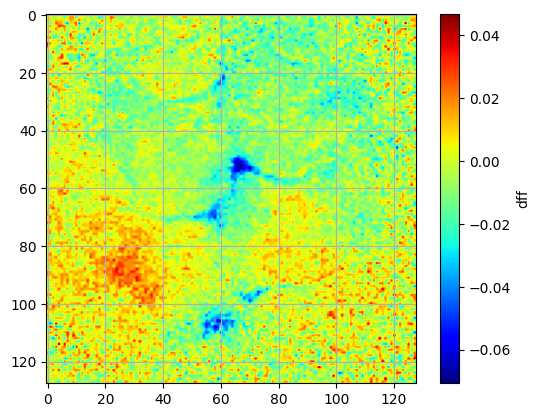

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:40,  3.13it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:39,  3.20it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.27it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:39,  3.14it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:38,  3.23it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:38,  3.18it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.18it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:40,  2.96it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:38,  3.07it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:39,  3.02it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:38,  3.06it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:37,  3.11it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.19it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.17it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.31it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:37,  2.97it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:36,  3.05it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:37,  2.97it/s]

 15%|████████████                                                                     | 19/128 [00:06<00:37,  2.94it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:36,  2.93it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.07it/s]

 17%|█████████████▉                                                                   | 22/128 [00:07<00:33,  3.19it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:32,  3.27it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.07it/s]

 20%|███████████████▊                                                                 | 25/128 [00:08<00:33,  3.04it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:33,  3.02it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:33,  3.06it/s]

 22%|█████████████████▋                                                               | 28/128 [00:09<00:32,  3.08it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:31,  3.15it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:31,  3.10it/s]

 24%|███████████████████▌                                                             | 31/128 [00:10<00:31,  3.08it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:31,  3.02it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:30,  3.09it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:30,  3.12it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:29,  3.18it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.25it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:27,  3.36it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:27,  3.26it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:27,  3.28it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:27,  3.15it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:27,  3.13it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.24it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.29it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:25,  3.28it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:26,  3.17it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.23it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:25,  3.20it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:26,  3.04it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:25,  3.10it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.22it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:23,  3.23it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:24,  3.07it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:23,  3.18it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:22,  3.23it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:22,  3.27it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.18it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:21,  3.24it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.33it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.14it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:22,  3.09it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:21,  3.18it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:19,  3.33it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:18,  3.42it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.16it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.27it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:19,  3.23it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:18,  3.27it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.27it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.37it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:22<00:16,  3.50it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:15,  3.59it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.24it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.34it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:15,  3.47it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.31it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.37it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:14,  3.49it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:14,  3.53it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:14,  3.50it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:13,  3.44it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:13,  3.41it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.36it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.26it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.23it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.13it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.17it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.21it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:13,  3.02it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.07it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.20it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.33it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.24it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:10,  3.29it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.31it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.27it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.17it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.18it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.18it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.24it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.20it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.29it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.37it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.32it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.10it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.17it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:33<00:06,  3.20it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.28it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.17it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:05,  3.27it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.36it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:04,  3.43it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.36it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.26it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.32it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:03,  3.33it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:36<00:03,  3.27it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.24it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:03,  3.33it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.32it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.28it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.27it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.36it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.32it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.25it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.22it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:39<00:00,  3.26it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.16it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.26it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.22it/s]

frame number 200 plotted


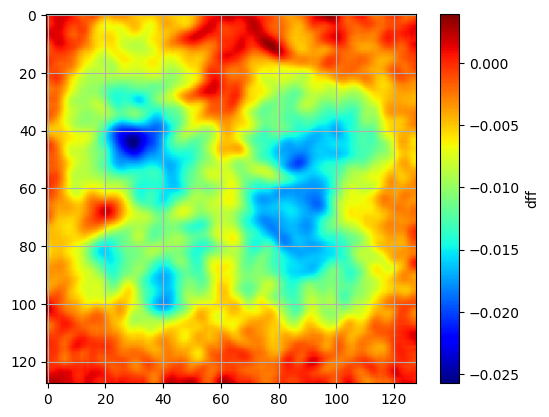

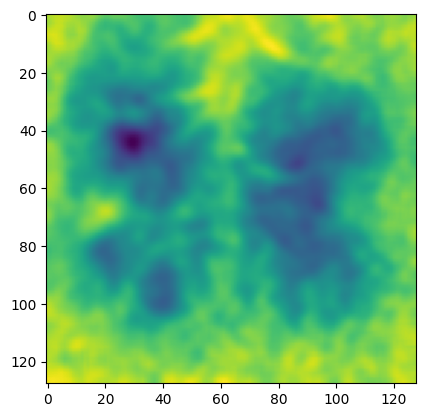

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 12


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 19
fail = 18
total trials = 37


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 21
fail = 30
total trials = 51


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 4
fail = 8
total trials = 12


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34866 [00:00<?, ?it/s]

  6%|████▌                                                                     | 2130/34866 [00:00<00:01, 21096.22it/s]

 13%|█████████▋                                                                | 4539/34866 [00:00<00:01, 22721.60it/s]

 20%|██████████████▍                                                           | 6812/34866 [00:00<00:01, 22423.28it/s]

 27%|████████████████████▎                                                     | 9561/34866 [00:00<00:01, 24309.40it/s]

 35%|█████████████████████████▌                                               | 12209/34866 [00:00<00:00, 24998.32it/s]

 42%|██████████████████████████████▊                                          | 14710/34866 [00:00<00:00, 21840.28it/s]

 49%|███████████████████████████████████▌                                     | 16956/34866 [00:00<00:00, 21331.34it/s]

 55%|████████████████████████████████████████                                 | 19130/34866 [00:00<00:00, 21266.74it/s]

 62%|█████████████████████████████████████████████▎                           | 21657/34866 [00:00<00:00, 22371.13it/s]

 69%|██████████████████████████████████████████████████▋                      | 24214/34866 [00:01<00:00, 23244.02it/s]

 77%|████████████████████████████████████████████████████████▎                | 26917/34866 [00:01<00:00, 24290.99it/s]

 85%|██████████████████████████████████████████████████████████████▏          | 29675/34866 [00:01<00:00, 25191.74it/s]

 93%|███████████████████████████████████████████████████████████████████▋     | 32352/34866 [00:01<00:00, 25586.28it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34866/34866 [00:01<00:00, 23872.42it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25008.52it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 13336.84it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")